# PROJET 3 - Concevez une application au service de la santé publique - Analyse exploratoire du jeu de données nettoyé Open Food Facts
Auteur : Henrique Da Costa - Parcours Data scientist chez Openclassrooms

Plan de l'analyse :

* 1. Idéé d'application
* 2. Import des données et paramètres d'affichage
* 3. Analyse univariée
* 4. Analyse bivariée
* 5. Analyse multivariée - ACP
* 6. Prédiction du nutriscore à partir des composantes principales PC1 à PC4
* 7. Annexe - Choix du modèle à partir des variables initiales et mesure de la perte de performance avec les composantes principales

## 1. IDEE D'APPLICATION

## Le Nutri-Score, cible de notre application

* **Qu’est-ce que le Nutri-Score ?**

Dans le cadre de la loi de Santé de 2016, le gouvernement français a recommandé la mise en place d’une information nutritionnelle claire, visible, et facile à comprendre pour tous. 
L’objectif : améliorer l’information nutritionnelle figurant sur les produits et ainsi aider les consommateurs à acheter des aliments de meilleure qualité nutritionnelle.
Valeur énergétique des produits, teneurs en graisses, acides gras saturés, glucides, sucres, protéines et sel pour 100 g ou 100 ml de produit : les informations y sont nombreuses.

Le Nutri-Score, grâce à une lettre et à une couleur, informe les consommateurs sur la qualité nutritionnelle d’un produit. Chaque produit est ainsi positionné sur une échelle à 5 niveaux allant :

1. du produit  le plus favorable sur le plan nutritionnel (classé A)
2. au produit le moins favorable sur le plan nutritionnel (classé E)

Cette graduation est attribuée en fonction de la composition du produit. Plus le produit contiendra de fibres, protéines et végétaux, plus sa classification tendra vers le A.

A l’inverse, plus celui-ci contiendra d’énergie, de sel, de sucre et d’acides gras saturés (AGS), plus sa classification tendra vers le E.

* **Quels sont les produits concernés ?**

Tous les produits transformés et les boissons sont concernés par le Nutri-Score **sauf quelques produits comme le thé, le café ou les herbes aromatiques. De même, les fruits, légumes et poissons frais ne sont pas concernés, ainsi que l'alcool.**

* **Comment est calculé le score d’un produit ?**

Pour classer chaque produit, des équipes de recherches internationales ont mis au point un score qui prend en compte, pour 100 grammes de produit, la teneur :

1. **en nutriments et aliments à favoriser** : fibres, protéines, fruits et légumes
2. **en nutriments à limiter** : énergie, acides gras saturés, sucres, sel

Après calcul, le score obtenu par un produit permet de lui attribuer une couleur et une lettre.

| Score final        | Couleur|Lettre|
|-----------|:------------:|:-----------:|
| Entre - 15 et - 2 |Vert|A|
|Entre  - 1 et + 3|Vert clair|B|
|Entre  + 4 et + 11|Jaune|C|
|Entre  + 12 et + 16|Orange|D
|Entre +17 et  + 40|Rouge|E|

* **Les catégories de produits**

les catégories de produits sont définies par le Pogramme National de Nutrition Santé (https://www.mangerbouger.fr/PNNS), ou PNNS, qui propose depuis 2001 des recommandations nutritionnelles pour prévenir l’apparition de certaines maladies et promouvoir la santé publique.

## Idée d'application => Prédire le nutriscore à partir de certains éléments nutritionnels de base

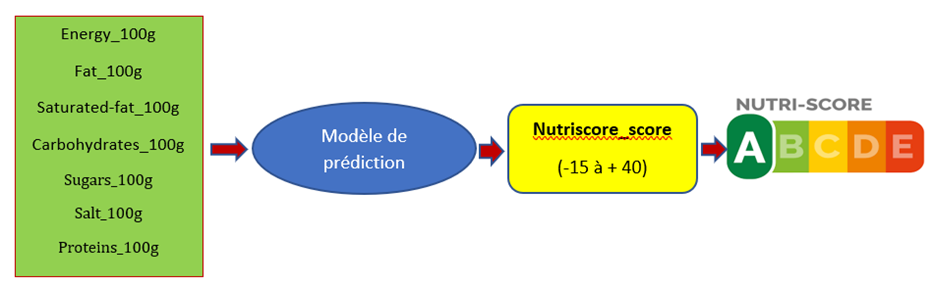

L'idée est de réaliser une application qui **aide le consommateur à améliorer ses habitudes de consommation.**

Connaissant la teneur en nutriments à éviter et le taux de protéines (nutriment favorable à la santé et à la pratique du sport amateur), l'idée est de permettre à tout un chacun et au sportif amateur en particulier de savoir si un aliment possède un score favorable à une bonne santé ou au contraire est à bannir.

**La connaissance du nutri-score de l’aliment permet de contrôler ce qu’on mange.** 

**Cette connaissance est fournie par un modèle prédictif estimant le nutriscore de l'aliment à partir de la composition de ces quelques nutriments de base dans une fourchette de - 15 (aliment le plus sain) à + 40 (aliment le moins sain)** et de traduire cela par une lettre de A (le plus favorable) à E (à éviter absolument).

L'objectif est de mettre au point une application légère permettant d’avoir une visualisation rapide du nutriscore pour manger de manière saine.

Cette application aurait vocation à être déployé sur PC et sur mobile.

## 2. IMPORT DES DONNEES ET PARAMETRES D'AFFICHAGE

In [16]:
## Librairies utilisées dans cette étude
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import missingno as msno
import os
from datetime import datetime
import time
import math
from dataprep.eda import *
from pandas_profiling import ProfileReport
from scipy import stats
sns.set()

## Modules de la librarie scikit-learn
from sklearn import decomposition
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

## Fonctions utiles pour l'analyse en composantes principales
from functions import *

### Paramètres d'affichage

In [17]:
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)

### Chargement du fichier de données

In [18]:
path_file = "data_cleaned.csv"

# Impression de la taille du jeu de données final
import os
print("La taille initiale du jeu de données est de : {} MB.".format(os.path.getsize(path_file)/10**6))

La taille initiale du jeu de données est de : 15.569336 MB.


In [19]:
# Chargement du jeu de données
df = pd.read_csv(path_file)

In [20]:
df.head(2)

,Unnamed: 0,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,pnns_groups_1,pnns_groups_2,nutriscore_grade,nutriscore_score
0,0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,Fat and sauces,Dressings and sauces,d,18.0
1,1,134.0,0.3,0.1,5.3,3.9,NaN,0.9,0.42,0.168,Composite foods,One-dish meals,b,1.0


In [21]:
df = df.drop(['Unnamed: 0'],axis=1)

In [23]:
df.head(2)

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,pnns_groups_1,pnns_groups_2,nutriscore_grade,nutriscore_score
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,Fat and sauces,Dressings and sauces,d,18.0
1,134.0,0.3,0.1,5.3,3.9,NaN,0.9,0.42,0.168,Composite foods,One-dish meals,b,1.0


In [24]:
# On s'assure que l'on repart avec le même fichier que celui sauvegardé au terme de la phase de nettoyage => C'est le cas
df.shape

(183634, 13)

## 3. ANALYSE UNIVARIEE

**Les analyses univariées et multivariées seront menées grâce à la librairie DataPrep.EDA qui permet d'obtenir des statistiques exhaustives et des visualisations de différentes natures.**

**Valeurs manquantes pour mémoire**


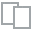
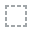
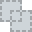
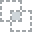
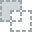
...
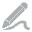
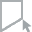
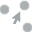
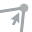
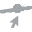

In [9]:
plot_missing(df)

In [10]:
#Nombre de valeur manquante
def nombre_manquantes(df):
    return sum(df.isnull())
# On applique cette fonction pour chaque colonne:
print("Valeurs manquantes par colonne:")
print(df.apply(nombre_manquantes, axis=0))

Valeurs manquantes par colonne:
energy_100g              290
fat_100g                 296
saturated-fat_100g       293
carbohydrates_100g       356
sugars_100g              292
fiber_100g            112131
proteins_100g            291
salt_100g                217
sodium_100g              217
pnns_groups_1            466
pnns_groups_2              0
nutriscore_grade           0
nutriscore_score           0
dtype: int64


In [11]:
print("Pourcentage de valeurs manquantes (%)")
print(df.apply(nombre_manquantes, axis=0)/df.shape[0]*100)

Pourcentage de valeurs manquantes (%)
energy_100g            0.157923
fat_100g               0.161190
saturated-fat_100g     0.159557
carbohydrates_100g     0.193864
sugars_100g            0.159012
fiber_100g            61.062222
proteins_100g          0.158467
salt_100g              0.118170
sodium_100g            0.118170
pnns_groups_1          0.253766
pnns_groups_2          0.000000
nutriscore_grade       0.000000
nutriscore_score       0.000000
dtype: float64


**Le jeu de données est exploitable en l'état car comportant trés peu de valeurs manquantes sauf pour la variable Fiber que l'on choisit de conserver à ce stade car c'est un élément important pour un nutriscore de qualité.**

### Remplacer les valeurs manquantes avec l'algorithme k Nearest Neighbors (k-NN) qui peut servir autant pour la regression que la classification

**L’imputation dans Scikit-learn -> Pour information**

Trois types d’imputeurs sont disponibles à l’heure actuelle : le SimpleImputer, qui implémente des stratégies classiques d’imputation univariée, le KNNImputer, qui implémente la stratégie par k-plus proches voisins, et l”IterativeImputer qui implémente à titre expérimental l’imputation itérative.

Scikit-learn gère (de façon expérimentale) l’imputation itérative. Pour l’utiliser, il est nécessaire d’activer le mode expérimental de scikit-learn :

* Mode expérimental

from sklearn.experimental import enable_iterative_imputer

* Import du IterativeImputer

from sklearn.impute import IterativeImputer

In [12]:
df.dtypes

energy_100g           float64
fat_100g              float64
saturated-fat_100g    float64
carbohydrates_100g    float64
sugars_100g           float64
fiber_100g            float64
proteins_100g         float64
salt_100g             float64
sodium_100g           float64
pnns_groups_1          object
pnns_groups_2          object
nutriscore_grade       object
nutriscore_score      float64
dtype: object

In [13]:
targuet = df['nutriscore_grade']
df_knn = df.select_dtypes(include='float64')
df_knn.head()

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,18.0
1,134.0,0.3,0.1,5.3,3.9,NaN,0.9,0.42,0.168,1.0
2,1594.0,22.0,15.5,27.3,21.9,4.4,4.6,0.10,0.040,14.0
3,657.0,0.0,0.0,36.0,27.0,3.6,0.6,0.00,0.000,-2.0
4,598.0,12.7,1.0,3.9,1.0,NaN,1.9,0.27,0.108,1.0


In [14]:
x = df_knn.to_numpy()
x

array([[ 9.360e+02,  8.200e+00,  2.200e+00, ...,  4.600e+00,  1.840e+00,
         1.800e+01],
       [ 1.340e+02,  3.000e-01,  1.000e-01, ...,  4.200e-01,  1.680e-01,
         1.000e+00],
       [ 1.594e+03,  2.200e+01,  1.550e+01, ...,  1.000e-01,  4.000e-02,
         1.400e+01],
       ...,
       [ 2.443e+03,  4.690e+01,  2.820e+01, ...,  3.000e-02,  1.200e-02,
         2.200e+01],
       [ 1.469e+03,  5.000e-01,  0.000e+00, ...,  0.000e+00,  0.000e+00,
         0.000e+00],
       [ 5.480e+02,  5.000e+00,  2.300e+00, ...,  1.800e-01,  7.200e-02,
        -2.000e+00]])

In [15]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=3)
imputer.fit_transform(x)
df_knn = pd.DataFrame(imputer.fit_transform(x))

In [17]:
df_knn.head()

,0,1,2,3,4,5,6,7,8,9
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,18.0
1,134.0,0.3,0.1,5.3,3.9,0.9,0.9,0.42,0.168,1.0
2,1594.0,22.0,15.5,27.3,21.9,4.4,4.6,0.10,0.040,14.0
3,657.0,0.0,0.0,36.0,27.0,3.6,0.6,0.00,0.000,-2.0
4,598.0,12.7,1.0,3.9,1.0,0.0,1.9,0.27,0.108,1.0


In [18]:
print(df_knn.apply(nombre_manquantes, axis=0))

0    0
1    0
2    0
3    0
4    0
5    0
6    0
7    0
8    0
9    0
dtype: int64


In [19]:
df_knn = df_knn.rename(columns={0: "energy_100g", 1: "fat_100g", 2: "saturated-fat_100g",3:"carbohydrates_100g",4:"sugars_100g",5:"fiber_100g",6:"proteins_100g",7:"salt_100g",8:"sodium_100g",9:"nutriscore_score"})
temp = pd.concat([df_knn, targuet], axis=1)
df_knn = temp
df_knn.head()

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,18.0,d
1,134.0,0.3,0.1,5.3,3.9,0.9,0.9,0.42,0.168,1.0,b
2,1594.0,22.0,15.5,27.3,21.9,4.4,4.6,0.10,0.040,14.0,d
3,657.0,0.0,0.0,36.0,27.0,3.6,0.6,0.00,0.000,-2.0,a
4,598.0,12.7,1.0,3.9,1.0,0.0,1.9,0.27,0.108,1.0,b


Nous avons retraité ici uniquement les variables numeriques constituées des éléments nutritifs impactant directement le nutriscore_score. L'algorithme k-NN nous a surtout servi à imputer les valeurs manquantes pour la variable 'fiber', les autres variables présentant trés peu de valeurs manquantes avant le traitement.

Nous reviendrons ultérieurement si besoin sur les variables catégorielles : pnns_groups_1 et pnns_groups_2. Parmi celles-ci seule pnnss_groups_1 présente un taux de valeurs manquantes de 25.37 %, l'autre variable ne rencontrant aucune valeur manquante.

**Comparons à présent la distribution du jeu de données avant et aprés le traitement des valeurs manquantes.**

### Distribution des variables avant traitement des valeurs manquantes


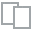
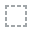
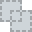
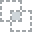
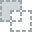
...
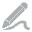
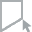
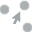
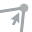
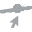

In [36]:
plot(df)

### Distribution des variables aprés traitement des valeurs manquantes


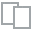
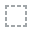
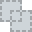
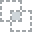
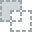
...
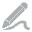
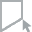
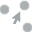
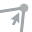
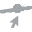

In [37]:
plot(df_knn)

### Regarder la tendance centrale et la dispersion de chaque variable avant et après le nettoyage (comparaison)


--------------------
energy_100g
moy:
 1160.7462422877222 & après nettoyage 1159.8629649883264
med:
 1049.0 & après nettoyage 1046.0
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 679969.799466419 & après nettoyage 679636.4745672394
ect:
 824.6028131569883 & après nettoyage 824.4006759866463
skw:
 6.803867060240753 & après nettoyage 6.8000045778527465
kur:
 618.9069694176183 & après nettoyage 618.5649417987121


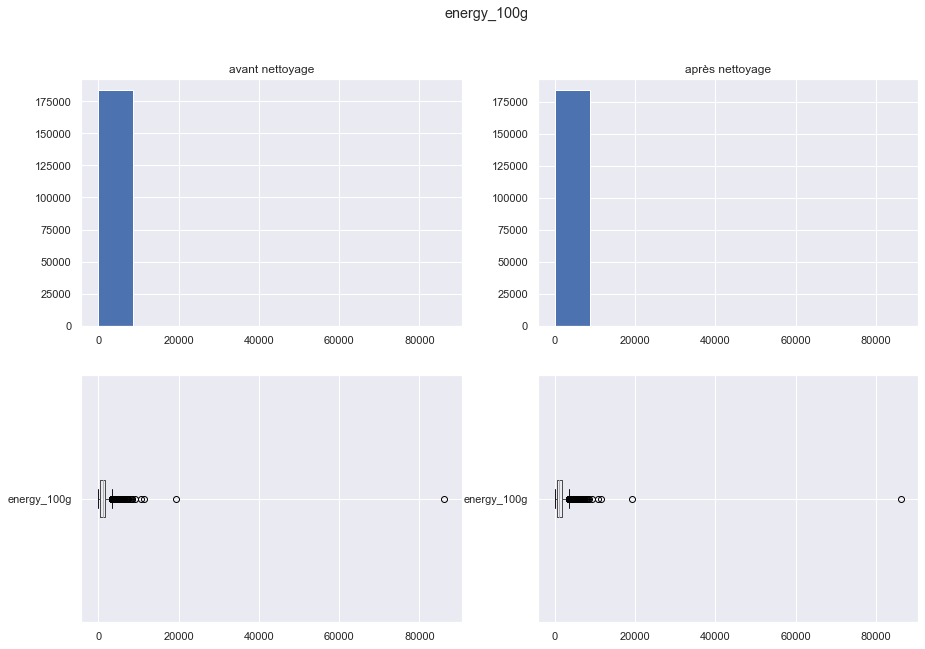

--------------------
fat_100g
moy:
 15.54436011591845 & après nettoyage 15.525518068180494
med:
 9.1 & après nettoyage 9.1
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 354.3804022105441 & après nettoyage 354.0576949049187
ect:
 18.824994082616442 & après nettoyage 18.816420884560344
skw:
 2.070029104904951 & après nettoyage 2.0720756231606
kur:
 5.34163189176504 & après nettoyage 5.352023822223078


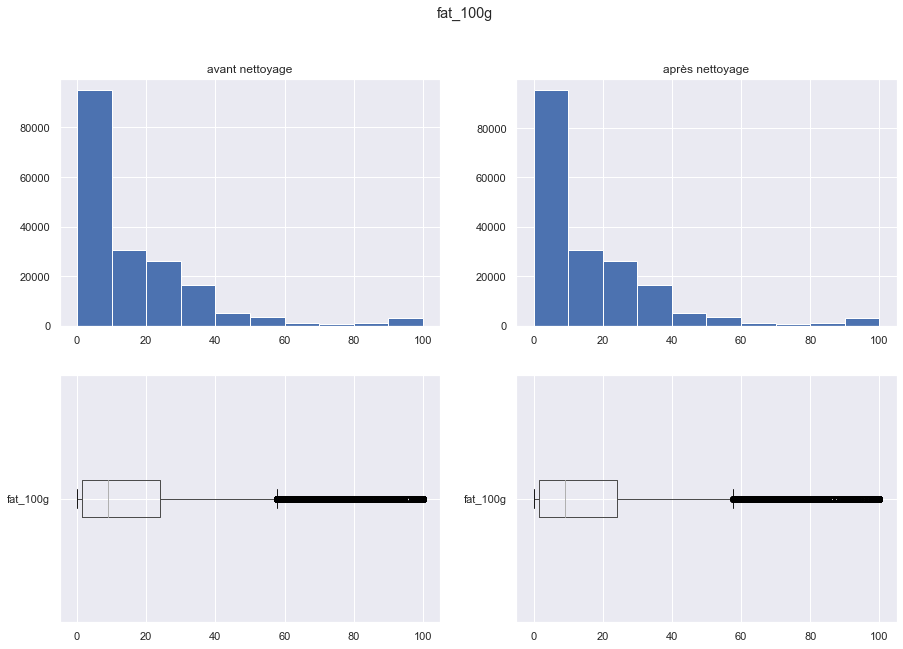

--------------------
saturated-fat_100g
moy:
 6.073331757089107 & après nettoyage 6.064753210243243
med:
 2.4 & après nettoyage 2.4
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 76.79418112402749 & après nettoyage 76.71854816355636
ect:
 8.763228921124194 & après nettoyage 8.75891249890969
skw:
 3.560197520361744 & après nettoyage 3.5623267223417763
kur:
 39.419279983975684 & après nettoyage 39.449336862851915


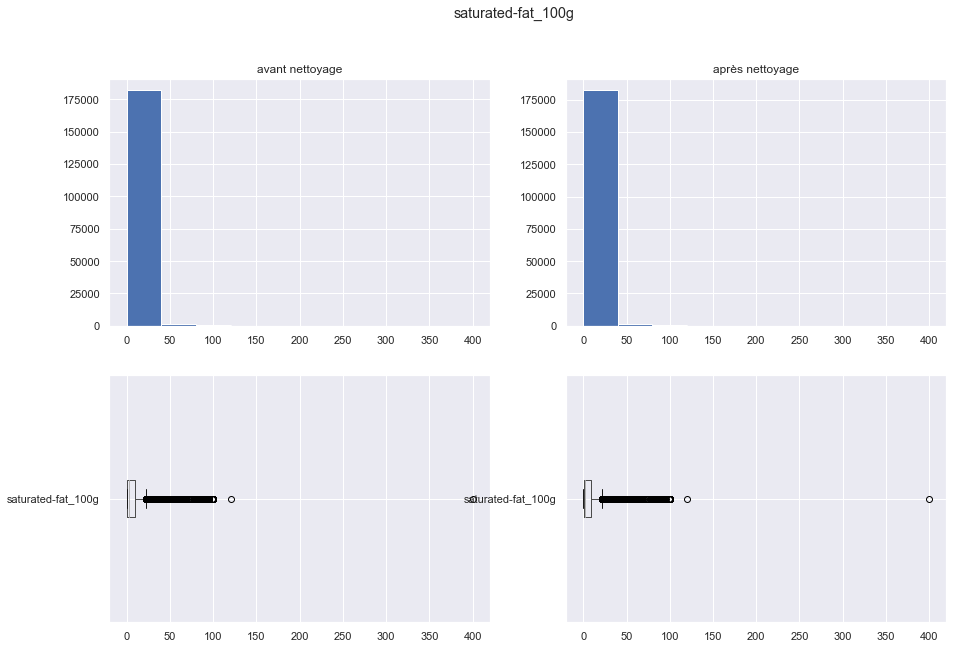

--------------------
carbohydrates_100g
moy:
 24.333177224031406 & après nettoyage 24.322975730525723
med:
 12.0 & après nettoyage 12.0
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 690.8485545737175 & après nettoyage 690.080255241551
ect:
 26.283998070569808 & après nettoyage 26.269378661124648
skw:
 0.8659701992802513 & après nettoyage 0.8664884849293903
kur:
 -0.5960078681847376 & après nettoyage -0.593193534934108


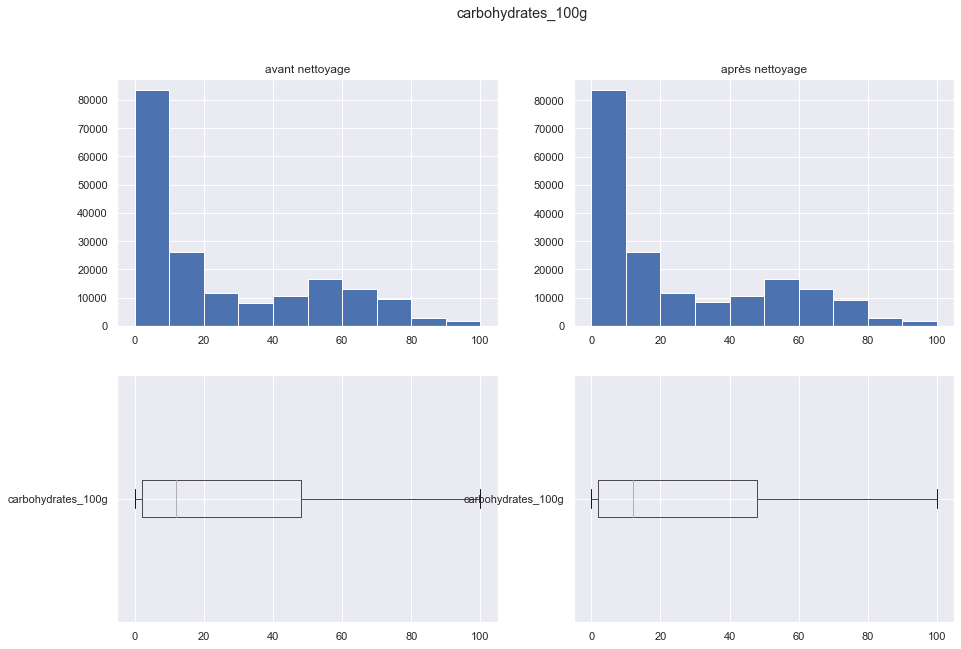

--------------------
sugars_100g
moy:
 12.405077553743666 & après nettoyage 12.388748809362472
med:
 3.0 & après nettoyage 3.0
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 339.69376619042475 & après nettoyage 339.3318073965115
ect:
 18.430783113867538 & après nettoyage 18.420961087753035
skw:
 1.8648313979011357 & après nettoyage 1.867212257452624
kur:
 3.0489804552136035 & après nettoyage 3.059064285086359


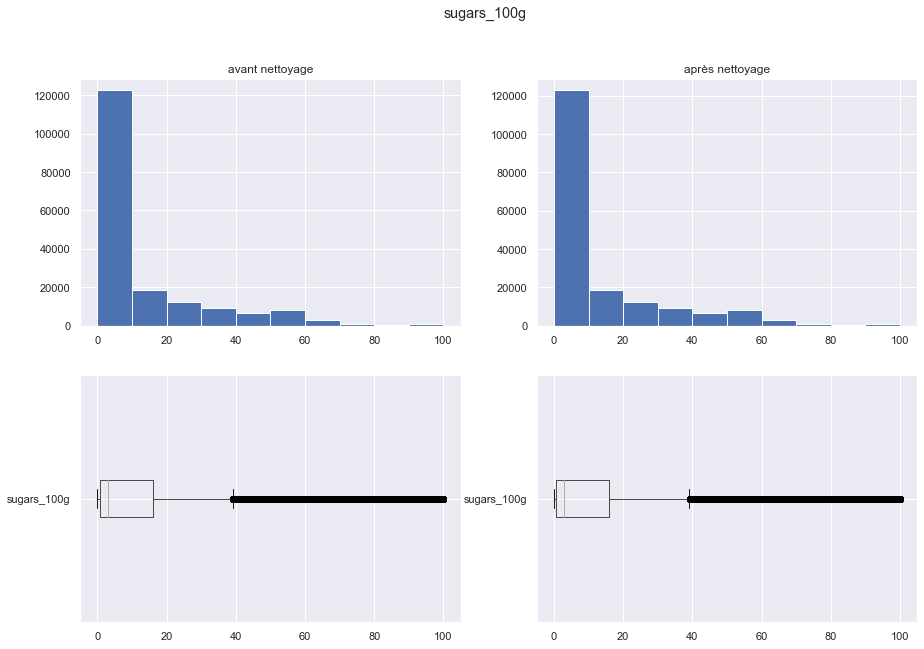

--------------------
fiber_100g
moy:
 2.611549420863497 & après nettoyage 1.7787255126682975
med:
 1.6 & après nettoyage 0.8333333333333334
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 15.254426841832506 & après nettoyage 9.106090177388108
ect:
 3.9056915958422147 & après nettoyage 3.01762989403739
skw:
 5.521324116534841 & après nettoyage 6.036574730899256
kur:
 63.93995681238478 & après nettoyage 81.15294909269257


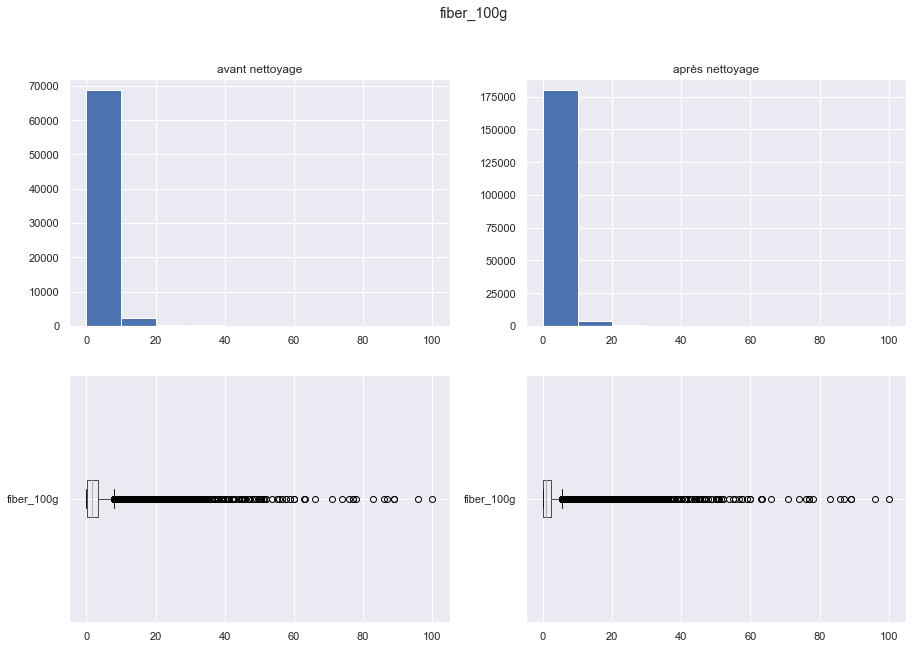

--------------------
proteins_100g
moy:
 8.778284868850694 & après nettoyage 8.772146367464812
med:
 6.4 & après nettoyage 6.425
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 70.10809018487507 & après nettoyage 70.04118370526417
ect:
 8.373057397681869 & après nettoyage 8.369061100581366
skw:
 1.379439801259847 & après nettoyage 1.380928258485836
kur:
 3.3947380994241003 & après nettoyage 3.4015111488944125


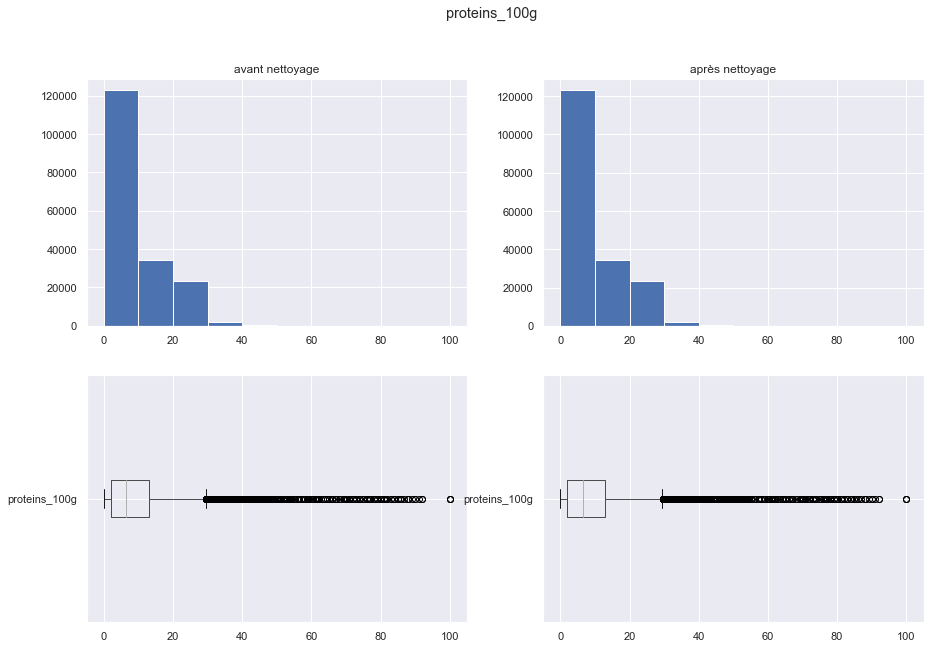

--------------------
salt_100g
moy:
 0.9860164397627208 & après nettoyage 0.9856424358885574
med:
 0.6 & après nettoyage 0.6
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 3.2240357504513733 & après nettoyage 3.220443299856474
ect:
 1.795560010261805 & après nettoyage 1.7945593609174575
skw:
 14.61222986634204 & après nettoyage 14.619991589994388
kur:
 508.3959020491819 & après nettoyage 508.94399819743626


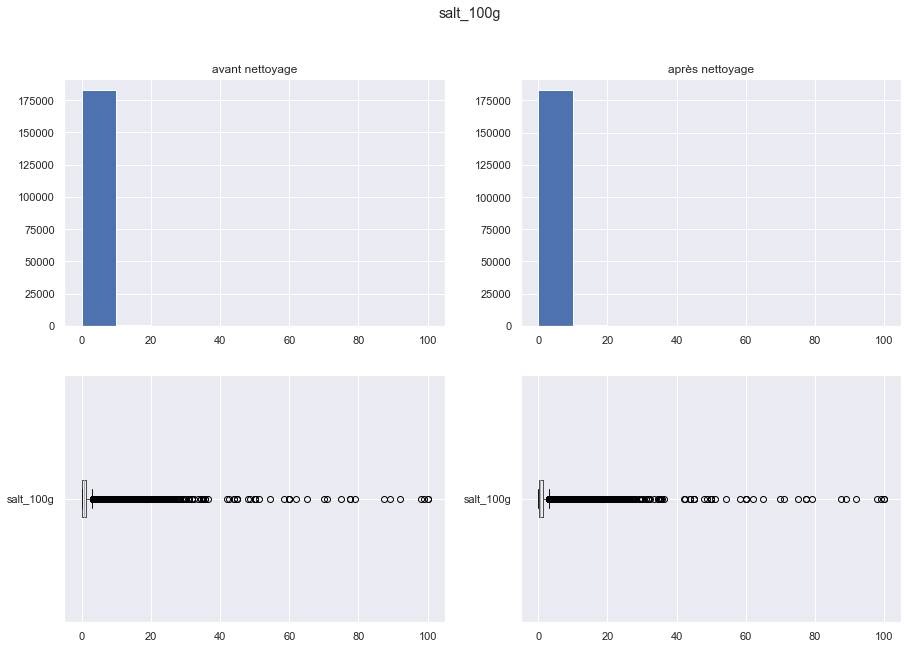

--------------------
sodium_100g
moy:
 0.3946924566757953 & après nettoyage 0.394542518390408
med:
 0.24000001 & après nettoyage 0.24000001
mod:
 0    0.0
dtype: float64 & après nettoyage 0    0.0
dtype: float64
var:
 0.5292975143109719 & après nettoyage 0.5287069112967168
ect:
 0.727528359798415 & après nettoyage 0.7271223496061147
skw:
 15.784786301948161 & après nettoyage 15.793153703314
kur:
 600.4276643751825 & après nettoyage 601.0749174912362


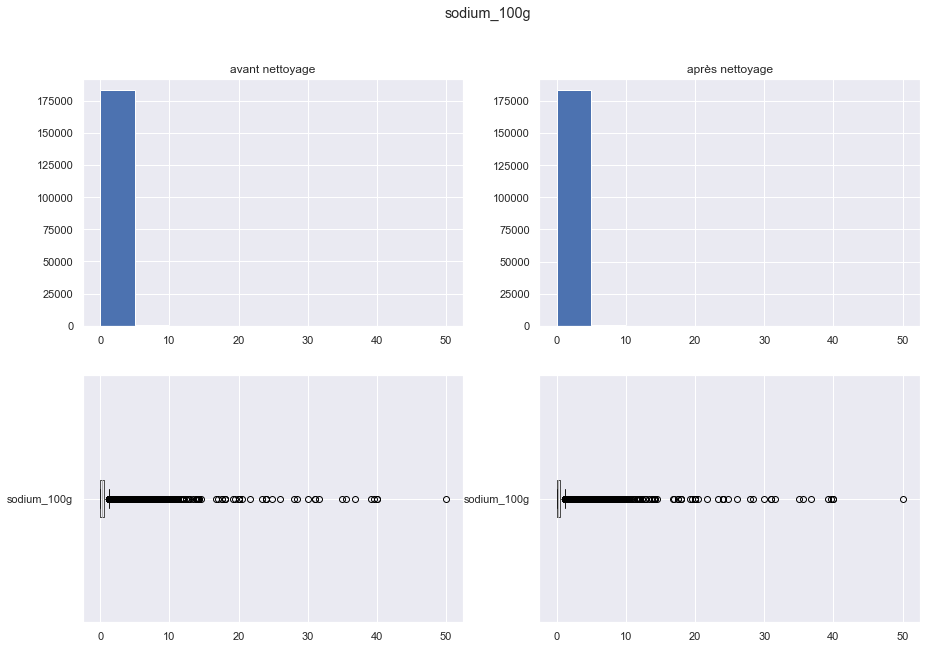

--------------------
nutriscore_score
moy:
 9.434374897894726 & après nettoyage 9.434374897894726
med:
 10.0 & après nettoyage 10.0
mod:
 0    14.0
dtype: float64 & après nettoyage 0    14.0
dtype: float64
var:
 78.53628223476284 & après nettoyage 78.53628223476284
ect:
 8.862069861762704 & après nettoyage 8.862069861762704
skw:
 0.09271626017275916 & après nettoyage 0.09271626017275916
kur:
 -0.9476812400859473 & après nettoyage -0.9476812400859473


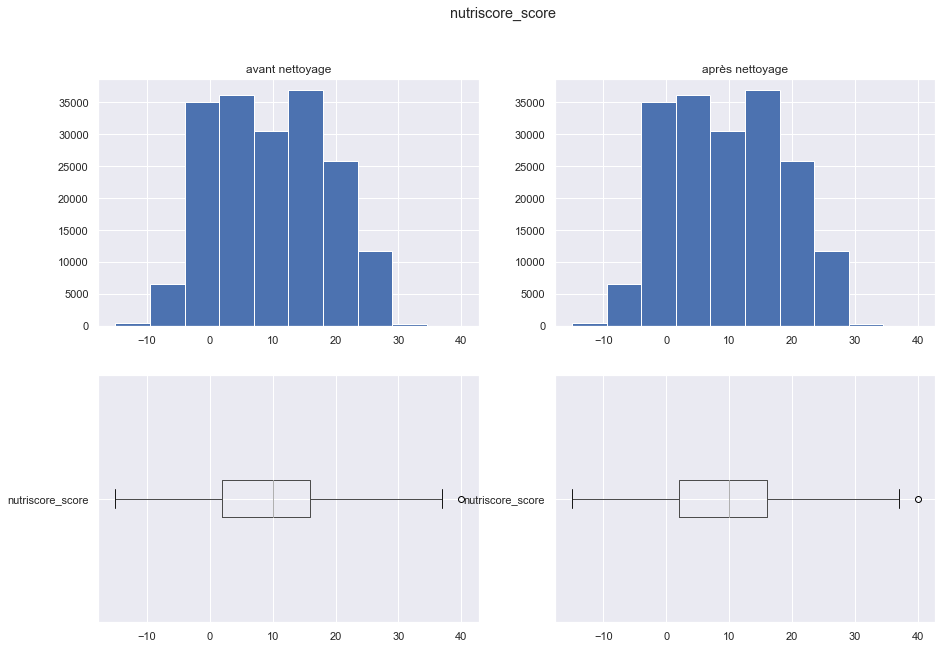

In [38]:
for col,col1 in zip(df.select_dtypes(include='float64'),df_knn):
    print("-"*20)
    print(col)
    print("moy:\n",df[col].mean(),"& après nettoyage",df_knn[col1].mean())
    print("med:\n",df[col].median(),"& après nettoyage",df_knn[col1].median())
    print("mod:\n",df[col].mode(),"& après nettoyage",df_knn[col1].mode())
    print("var:\n",df[col].var(ddof=0),"& après nettoyage",df_knn[col1].var(ddof=0))
    print("ect:\n",df[col].std(ddof=0),"& après nettoyage",df_knn[col1].std(ddof=0))
    print("skw:\n",df[col].skew(),"& après nettoyage",df_knn[col1].skew()) # 0 : symétrique / plus grand étalé à droite /plus petit : étalé à gauche
    print("kur:\n",df[col].kurtosis(),"& après nettoyage",df_knn[col1].kurtosis()) # plus grand que 0 : les observations sont concentrées
    plt.figure(figsize=(15, 10))
    plt.subplot(221)
    plt.suptitle(col)
    plt.title('avant nettoyage')
    df[col].hist()
    plt.subplot(222)
    plt.title('après nettoyage')
    df_knn[col1].hist()
    plt.subplot(223)
    df.boxplot(column=col, vert=False)
    plt.subplot(224)
    df_knn.boxplot(column=col1, vert=False,)
    plt.show()

In [39]:
df_knn

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,0.000000,5.1,4.60,1.840,18.0,d
1,134.0,0.3,0.1,5.3,3.9,0.900000,0.9,0.42,0.168,1.0,b
2,1594.0,22.0,15.5,27.3,21.9,4.400000,4.6,0.10,0.040,14.0,d
3,657.0,0.0,0.0,36.0,27.0,3.600000,0.6,0.00,0.000,-2.0,a
4,598.0,12.7,1.0,3.9,1.0,0.000000,1.9,0.27,0.108,1.0,b
...,...,...,...,...,...,...,...,...,...,...,...
183629,297.0,0.6,0.2,18.0,2.9,2.200000,0.5,0.01,0.004,-5.0,a
183630,967.0,9.8,3.5,23.8,5.5,2.866667,10.0,1.23,0.492,11.0,d
183631,2443.0,46.9,28.2,30.7,26.9,12.500000,7.6,0.03,0.012,22.0,e
183632,1469.0,0.5,0.0,80.0,0.0,0.000000,7.0,0.00,0.000,0.0,b


Compte tenu du faible taux de valeurs manquantes pour l'ensemble des variables (hormis le 'fiber_100g'), les distributions et les différents indicateurs statistiques sont quasiment identiques. **S'agissant de 'fiber_100g' :**


| Indicateur        | Avant traitement|Aprés traitement|
|-----------|:------------:|:-----------:|
| Moyenne |2.61|1.78|
|Variance|15.25|9.10|
|Ecart-type|3.90|3.01|
|Skew|5.52|6.03|
|Kurtosis|63.93|81.15|

Nous allons poursuivre notre étude avec la variable 'fiber_100g' ainsi corrigé des valeurs manquantes. Si de forts biais devaient persister, nous la retirerions.

In [40]:
data_analyse = df_knn

data_analyse.to_csv("C:\openclassrooms\Projet_3\data_analyse.csv")

data_analyse.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183634 entries, 0 to 183633
Data columns (total 11 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   energy_100g         183634 non-null  float64
 1   fat_100g            183634 non-null  float64
 2   saturated-fat_100g  183634 non-null  float64
 3   carbohydrates_100g  183634 non-null  float64
 4   sugars_100g         183634 non-null  float64
 5   fiber_100g          183634 non-null  float64
 6   proteins_100g       183634 non-null  float64
 7   salt_100g           183634 non-null  float64
 8   sodium_100g         183634 non-null  float64
 9   nutriscore_score    183634 non-null  float64
 10  nutriscore_grade    183634 non-null  object 
dtypes: float64(10), object(1)
memory usage: 15.4+ MB


In [20]:
path_file = "data_analyse.csv"
data = pd.read_csv(path_file)
data = data.drop(['Unnamed: 0'],axis=1)
data.head()

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.60,1.840,18.0,d
1,134.0,0.3,0.1,5.3,3.9,0.9,0.9,0.42,0.168,1.0,b
2,1594.0,22.0,15.5,27.3,21.9,4.4,4.6,0.10,0.040,14.0,d
3,657.0,0.0,0.0,36.0,27.0,3.6,0.6,0.00,0.000,-2.0,a
4,598.0,12.7,1.0,3.9,1.0,0.0,1.9,0.27,0.108,1.0,b


* **Zoom sur les nutriments**


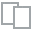
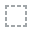
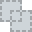
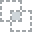
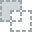
...
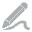
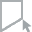
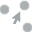
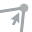
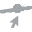

In [42]:
plot(data, 'energy_100g')


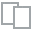
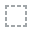
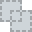
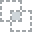
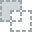
...
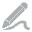
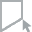
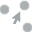
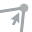
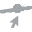

In [43]:
plot(data, 'fat_100g')


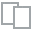
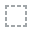
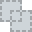
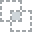
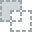
...
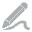
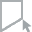
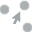
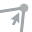
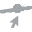

In [44]:
plot(data, 'saturated-fat_100g')


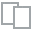
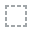
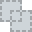
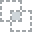
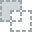
...
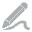
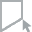
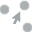
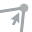
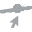

In [45]:
plot(data, 'carbohydrates_100g')


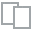
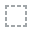
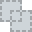
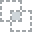
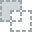
...
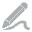
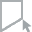
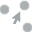
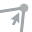
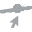

In [46]:
plot(data, 'sugars_100g')


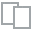
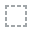
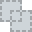
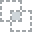
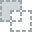
...
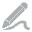
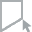
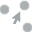
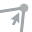
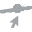

In [47]:
plot(data, 'fiber_100g')


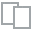
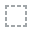
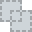
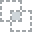
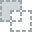
...
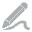
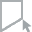
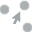
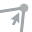
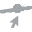

In [48]:
plot(data, 'proteins_100g')


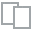
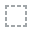
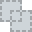
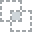
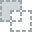
...
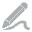
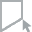
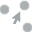
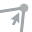
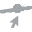

In [49]:
plot(data, 'salt_100g')


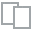
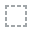
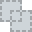
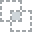
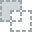
...
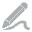
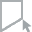
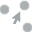
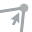
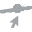

In [50]:
plot(data, 'sodium_100g')

#### Synthèse de l'analyse univariée

* Les distributions de chacune des variables ne semblent pas suivre une Loi normale. Cela sera confirmée par des tests statistiques de normalité.  En effet, autant l'observation de la forme des distributions que les mesures de symétrie (Skew) et d'aplatissement (Kurtosis), de même que l'observation des dispersions permises par les boxplots ou encore les diagrammes Q-Q Plot convergent vers la négation d'une Loi normale.

* On distingue 4 groupes distincts quand à l'allure de la distribution :

    * energy_100g, saturated-fat_100g, fiber_100g, salt_100g, sodium_100g.
    * fat_100g, carbohydrates_100g, sugars_100g.
    * proteins_100g.
    * nutriscore_100g.

Les 3 premiers groupes ont une distribution décalée vers la droite tandis  que le dernier (nutriscore) présente une distribution bimodale.

* **Test de normalité pour confirmer que ces distributions ne suivent pas une Loi normale**

Il existe plusieurs tests pour affirmer la normalité d'une distribution. Tous ces tests ont en commun d'avoir comme hypthèse nulle: La distribution empirique suit une loi Gaussienne.

**Test de Shapiro-Wilk**
    
Un des tests permettant de vérifier la normalité de la variable x est le test de Shapiro-Wilk. Il est appliquable pour des échantillons allant jusqu'à 50 valeurs. Il utilise le rapport de deux estimations de la variance. Dans le cas d'une variable normale, ces deux estimations coïncident et le rapport est voisin de 1, alors que si la variable n'est pas normale le rapport est plus petit que 1. => Pas utilisé ici car le volume du jeu de données est trop grand.

**Test de Kolmogorov-Smirnov**

Le test de Kolmogorov-Smirnov permet de tester l'ajustement des données x à n'importe quelle loi, dont la loi normale. Il est intéressant d'opter pour ce test plutôt que celui de Shapiro-Wilk en cas de très grands échantillons. Ce test détermine si les observations d'un échantillon peuvent raisonnablement provenir d'une distribution théorique donnée.

**Test K ^2 de D’Agostino-Pearson**

Le test K ^2 de D’Agostino-Pearson est considéré comme plus puissant que le test de Kolmogorov-Smirnov. Il se base sur le coefficient d’asymétrie (appelé également coefficient of Skewness ou coefficient \beta_1 de Pearson) et d’aplatissement (appelé également coefficient of Kurtosis ou coefficient \beta_2 de Pearson). 

**Test d'Anderson-Darling**

Le test d'Anderson-Darling est une variante du test de Kolmogorov-Smirnov pour l'hypothèse nulle où un échantillon est tiré d'une population qui suit une distribution particulière. Il est plus sensible que le test de Kolmogorov-Smirnov aux valeurs extrêmes.

In [87]:
def test_norm(dataframe):
    
    print('TEST DE SHAPIRO')
    print('-'*70)
    from scipy.stats import shapiro
    for col in dataframe.select_dtypes('float64'):
        stat, p = shapiro(dataframe[col])
        print(col, shapiro_test)
        if p > 0.05:
            print('Probablement gaussien')
        else:
            print('Probablement non gaussien')
    print('-'*70)
    
    print('TEST DE KOLMOGOROV-SMIRNOV')
    print('-'*70)
    from scipy.stats import kstest
    for col in dataframe.select_dtypes('float64'):
        stat, p = kstest(dataframe[col], cdf='norm') 
        print(col, kstest)
        if p > 0.05:
            print('pvalue =', p, ', statistic', stat, ' : Probablement gaussien')
        else:
            print('pvalue =', p, ', statistic', stat, ' : Probablement non gaussien')
    print('-'*70)
        
    print("TEST K2 DE D'AGOSTINO")
    print('-'*70)
    from scipy.stats import normaltest
    for col in dataframe.select_dtypes('float64'):
        stat, p = normaltest(dataframe[col])
        print(col, normaltest)
        if p > 0.05:
            print('pvalue =', p, ', statistic', stat, ' : Probablement gaussien')
        else:
            print('pvalue =', p, ', statistic', stat, ' : Probablement non gaussien')
    print('-'*70)  
    
    print("TEST D'ANDERSON-DARLIN")
    print('-'*70)
    from scipy.stats import anderson
    for col in dataframe.select_dtypes('float64'):
        result = anderson(dataframe[col])
        print('stat=%.3f' % (result.statistic))
        for i in range(len(result.critical_values)):
            sl, cv = result.significance_level[i], result.critical_values[i]
            if result.statistic < cv:
                print(col, ' : Probablement Gaussian au %.1f%% level' % (sl))
            else:
                print(col, ' : Probablement non Gaussien au %.1f%% level' % (sl))
    print('-'*70)  

In [88]:
test_norm(data)

TEST DE SHAPIRO
----------------------------------------------------------------------
energy_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
fat_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
saturated-fat_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
carbohydrates_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
sugars_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
fiber_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
proteins_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
salt_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
sodium_100g ShapiroResult(statistic=0.9750341176986694, pvalue=0.0)
Probablement non gaussien
nutriscore_score ShapiroResult(statistic=0.97503411769866

Les différents test statistiques confirment que la distribution de chacune de nos variables ne suit pas une loi normale. Il conviendra d'en tenir compte dans l'utilisation des différents modèles déployés.

## 4. ANALYSE BIVARIEE

**Pour mémoire, on repart bien avec un jeu de données ne contenant aucune valeur manquante.**

In [25]:
#Nombre de valeur manquante
def nombre_manquantes(data):
    return sum(data.isnull())
# On applique cette fonction pour chaque colonne:
print("Valeurs manquantes par colonne:")
print(data.apply(nombre_manquantes, axis=0))

Valeurs manquantes par colonne:
energy_100g           0
fat_100g              0
saturated-fat_100g    0
carbohydrates_100g    0
sugars_100g           0
fiber_100g            0
proteins_100g         0
salt_100g             0
sodium_100g           0
nutriscore_score      0
nutriscore_grade      0
dtype: int64



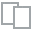
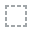
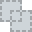
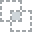
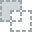
...
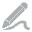
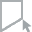
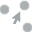
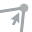
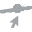

In [21]:
plot(data, 'energy_100g', 'nutriscore_score')


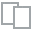
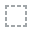
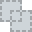
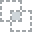
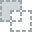
...
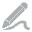
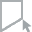
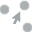
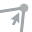
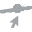

In [22]:
plot(data, 'fat_100g', 'nutriscore_score' )

In [66]:
df.columns.tolist()

['energy_100g',
 'fat_100g',
 'saturated-fat_100g',
 'carbohydrates_100g',
 'sugars_100g',
 'fiber_100g',
 'proteins_100g',
 'salt_100g',
 'sodium_100g',
 'pnns_groups_1',
 'pnns_groups_2',
 'nutriscore_grade',
 'nutriscore_score']


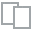
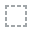
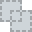
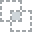
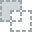
...
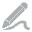
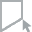
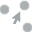
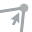
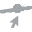

In [23]:
plot(data, 'saturated-fat_100g', 'nutriscore_score' )


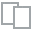
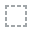
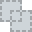
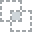
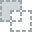
...
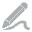
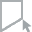
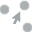
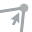
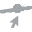

In [24]:
plot(data, 'carbohydrates_100g', 'nutriscore_score' )


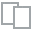
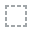
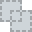
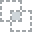
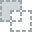
...
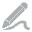
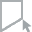
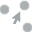
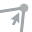
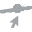

In [25]:
plot(data, 'sugars_100g', 'nutriscore_score' )


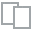
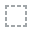
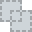
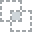
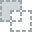
...
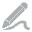
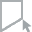
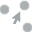
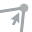
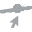

In [26]:
plot(data, 'fiber_100g', 'nutriscore_score' )


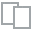
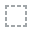
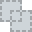
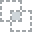
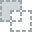
...
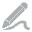
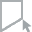
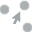
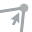
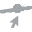

In [27]:
plot(data, 'proteins_100g', 'nutriscore_score' )


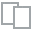
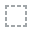
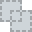
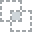
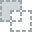
...
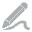
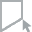
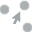
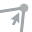
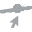

In [28]:
plot(data, 'salt_100g', 'nutriscore_score' )


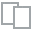
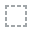
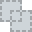
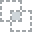
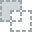
...
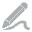
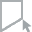
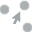
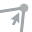
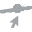

In [29]:
plot(data, 'sodium_100g', 'nutriscore_score' )


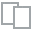
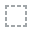
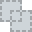
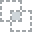
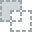
...
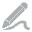
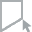
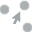
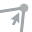
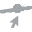

In [30]:
plot(data, 'nutriscore_grade', 'nutriscore_score' )


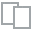
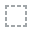
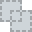
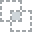
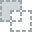
...
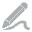
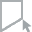
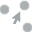
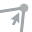
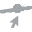

In [75]:
plot_correlation(data, 'sodium_100g', 'salt_100g')

**Comme l'on pouvait le présumer, 'salt' et 'sodium' sont parfaitement corrélés. On retirera donc la variable 'sodium' de notre jeu de données dans la suite de notre analyse.**

### Corrélation entre les différentes variables

Dés lors que l’on analyse des données il est important (particulièrement si vous faites du Machine Learning) de détecter si vos variables (features) sont liées.

En probabilités et en statistique, la corrélation entre plusieurs variables aléatoires ou statistiques est une notion de liaison qui contredit leur indépendance.

* **Relation linéaire entre deux variables continues = corrélation de Pearson (r).**

Les coefficients de Pearson (r) montrent une corrélation positive (r>0), négative (r<0) ou l'absence de corrélation (r=0).

* **Relation non linéaire : corrélation de Spearman (rho).**

Toutes les relations de dépendances ne sont pas forcément linéaires, il va donc falloir pousser plus loin les régressions (polynomiale, etc.).
On étudie la corrélation de Spearman quand deux variables statistiques semblent corrélées sans que la relation entre les deux variables soit de type affine. Elle consiste à trouver un coefficient de corrélation, non pas entre les valeurs prises par les deux variables mais entre les rangs de ces valeurs. Elle estime à quel point la relation entre deux variables peut être décrite par une fonction monotone.

* **Relation non linéaire : taux de Kendall.**

Cette mesure permet de mesurer l’association entre deux variables. Plus spécifiquement, le tau de Kendall mesure la corrélation de rang entre deux variables.

* **Différences entre les mesures de Spearman et de Kendall.**

**Tau de Kendall:** renvoie des valeurs généralement inférieures à la corrélation rho de Spearman. Les calculs sont basés sur des paires concordantes et discordantes. Cette méthode est insensible à l’erreur. Les valeurs sont plus précises avec des échantillons plus petits.

**Rho de Spearman:** donne des valeurs généralement plus grandes que le Tau de Kendall. Les calculs sont basés sur les déviations. il est beaucoup plus sensible aux erreurs et aux divergences dans les données (outliers).


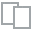
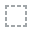
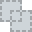
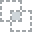
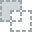
...
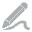
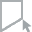
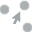
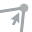
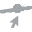

In [76]:
plot_correlation(data)

* **Pearson**

In [77]:
data.corr(method='pearson')

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.000000,0.775775,0.572265,0.355235,0.242819,0.207413,0.122084,-0.009808,-0.010053,0.552590
fat_100g,0.775775,1.000000,0.705776,-0.152740,-0.088149,0.039837,0.106019,0.049550,0.048647,0.488674
saturated-fat_100g,0.572265,0.705776,1.000000,-0.087195,0.009305,0.000638,0.155452,0.028084,0.027532,0.584039
carbohydrates_100g,0.355235,-0.152740,-0.087195,1.000000,0.708118,0.285401,-0.263094,-0.182667,-0.180479,0.209998
sugars_100g,0.242819,-0.088149,0.009305,0.708118,1.000000,0.115220,-0.334419,-0.200157,-0.197572,0.374455
fiber_100g,0.207413,0.039837,0.000638,0.285401,0.115220,1.000000,0.014616,-0.061533,-0.060981,-0.086767
proteins_100g,0.122084,0.106019,0.155452,-0.263094,-0.334419,0.014616,1.000000,0.275129,0.271365,0.088018
salt_100g,-0.009808,0.049550,0.028084,-0.182667,-0.200157,-0.061533,0.275129,1.000000,0.987015,0.224063
sodium_100g,-0.010053,0.048647,0.027532,-0.180479,-0.197572,-0.060981,0.271365,0.987015,1.000000,0.221410
nutriscore_score,0.552590,0.488674,0.584039,0.209998,0.374455,-0.086767,0.088018,0.224063,0.221410,1.000000


In [78]:
data.corr(method='pearson').style.format("{:.2}").background_gradient(cmap=plt.get_cmap('coolwarm'))

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.0,0.78,0.57,0.36,0.24,0.21,0.12,-0.0098,-0.01,0.55
fat_100g,0.78,1.0,0.71,-0.15,-0.088,0.04,0.11,0.05,0.049,0.49
saturated-fat_100g,0.57,0.71,1.0,-0.087,0.0093,0.00064,0.16,0.028,0.028,0.58
carbohydrates_100g,0.36,-0.15,-0.087,1.0,0.71,0.29,-0.26,-0.18,-0.18,0.21
sugars_100g,0.24,-0.088,0.0093,0.71,1.0,0.12,-0.33,-0.2,-0.2,0.37
fiber_100g,0.21,0.04,0.00064,0.29,0.12,1.0,0.015,-0.062,-0.061,-0.087
proteins_100g,0.12,0.11,0.16,-0.26,-0.33,0.015,1.0,0.28,0.27,0.088
salt_100g,-0.0098,0.05,0.028,-0.18,-0.2,-0.062,0.28,1.0,0.99,0.22
sodium_100g,-0.01,0.049,0.028,-0.18,-0.2,-0.061,0.27,0.99,1.0,0.22
nutriscore_score,0.55,0.49,0.58,0.21,0.37,-0.087,0.088,0.22,0.22,1.0


* **Spearman**

In [79]:
data.corr(method='spearman')

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.000000,0.754004,0.663633,0.330867,0.173241,0.224207,0.278419,0.087873,0.087836,0.617700
fat_100g,0.754004,1.000000,0.907578,-0.157474,-0.159137,0.045707,0.407774,0.354180,0.354167,0.607685
saturated-fat_100g,0.663633,0.907578,1.000000,-0.150132,-0.110115,-0.028233,0.418530,0.328424,0.328409,0.656683
carbohydrates_100g,0.330867,-0.157474,-0.150132,1.000000,0.767024,0.540152,-0.243935,-0.311042,-0.311061,0.128062
sugars_100g,0.173241,-0.159137,-0.110115,0.767024,1.000000,0.375938,-0.399658,-0.386153,-0.386163,0.260080
fiber_100g,0.224207,0.045707,-0.028233,0.540152,0.375938,1.000000,-0.045583,-0.053102,-0.053150,-0.045868
proteins_100g,0.278419,0.407774,0.418530,-0.243935,-0.399658,-0.045583,1.000000,0.515032,0.515034,0.111075
salt_100g,0.087873,0.354180,0.328424,-0.311042,-0.386153,-0.053102,0.515032,1.000000,0.999932,0.318534
sodium_100g,0.087836,0.354167,0.328409,-0.311061,-0.386163,-0.053150,0.515034,0.999932,1.000000,0.318549
nutriscore_score,0.617700,0.607685,0.656683,0.128062,0.260080,-0.045868,0.111075,0.318534,0.318549,1.000000


In [80]:
data.corr(method='spearman').style.format("{:.2}").background_gradient(cmap=plt.get_cmap('coolwarm'))

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.0,0.75,0.66,0.33,0.17,0.22,0.28,0.088,0.088,0.62
fat_100g,0.75,1.0,0.91,-0.16,-0.16,0.046,0.41,0.35,0.35,0.61
saturated-fat_100g,0.66,0.91,1.0,-0.15,-0.11,-0.028,0.42,0.33,0.33,0.66
carbohydrates_100g,0.33,-0.16,-0.15,1.0,0.77,0.54,-0.24,-0.31,-0.31,0.13
sugars_100g,0.17,-0.16,-0.11,0.77,1.0,0.38,-0.4,-0.39,-0.39,0.26
fiber_100g,0.22,0.046,-0.028,0.54,0.38,1.0,-0.046,-0.053,-0.053,-0.046
proteins_100g,0.28,0.41,0.42,-0.24,-0.4,-0.046,1.0,0.52,0.52,0.11
salt_100g,0.088,0.35,0.33,-0.31,-0.39,-0.053,0.52,1.0,1.0,0.32
sodium_100g,0.088,0.35,0.33,-0.31,-0.39,-0.053,0.52,1.0,1.0,0.32
nutriscore_score,0.62,0.61,0.66,0.13,0.26,-0.046,0.11,0.32,0.32,1.0


* **Kendall**

In [81]:
data.corr(method='kendall')

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.000000,0.597501,0.491382,0.228543,0.112732,0.158812,0.185347,0.061327,0.061290,0.455297
fat_100g,0.597501,1.000000,0.758320,-0.106420,-0.111710,0.035923,0.298588,0.257061,0.256996,0.436530
saturated-fat_100g,0.491382,0.758320,1.000000,-0.100989,-0.078590,-0.018927,0.299736,0.230643,0.230585,0.480723
carbohydrates_100g,0.228543,-0.106420,-0.100989,1.000000,0.625553,0.394895,-0.155965,-0.216558,-0.216524,0.090526
sugars_100g,0.112732,-0.111710,-0.078590,0.625553,1.000000,0.266530,-0.288728,-0.270501,-0.270452,0.181566
fiber_100g,0.158812,0.035923,-0.018927,0.394895,0.266530,1.000000,-0.014807,-0.040781,-0.040808,-0.031622
proteins_100g,0.185347,0.298588,0.299736,-0.155965,-0.288728,-0.014807,1.000000,0.382456,0.382385,0.069537
salt_100g,0.061327,0.257061,0.230643,-0.216558,-0.270501,-0.040781,0.382456,1.000000,0.999712,0.222202
sodium_100g,0.061290,0.256996,0.230585,-0.216524,-0.270452,-0.040808,0.382385,0.999712,1.000000,0.222174
nutriscore_score,0.455297,0.436530,0.480723,0.090526,0.181566,-0.031622,0.069537,0.222202,0.222174,1.000000


In [82]:
data.corr(method='kendall').style.format("{:.2}").background_gradient(cmap=plt.get_cmap('coolwarm'))

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.0,0.6,0.49,0.23,0.11,0.16,0.19,0.061,0.061,0.46
fat_100g,0.6,1.0,0.76,-0.11,-0.11,0.036,0.3,0.26,0.26,0.44
saturated-fat_100g,0.49,0.76,1.0,-0.1,-0.079,-0.019,0.3,0.23,0.23,0.48
carbohydrates_100g,0.23,-0.11,-0.1,1.0,0.63,0.39,-0.16,-0.22,-0.22,0.091
sugars_100g,0.11,-0.11,-0.079,0.63,1.0,0.27,-0.29,-0.27,-0.27,0.18
fiber_100g,0.16,0.036,-0.019,0.39,0.27,1.0,-0.015,-0.041,-0.041,-0.032
proteins_100g,0.19,0.3,0.3,-0.16,-0.29,-0.015,1.0,0.38,0.38,0.07
salt_100g,0.061,0.26,0.23,-0.22,-0.27,-0.041,0.38,1.0,1.0,0.22
sodium_100g,0.061,0.26,0.23,-0.22,-0.27,-0.041,0.38,1.0,1.0,0.22
nutriscore_score,0.46,0.44,0.48,0.091,0.18,-0.032,0.07,0.22,0.22,1.0


* **Corrélation de la variable 'fiber' avec la variable cible 'nutriscore_score'**

Il apparaît que **'fiber' n'est absolument pas corrélée avec 'nutriscore_score'** contrairement à ce que l'on pouvait présupposer. C'est contre-intuitif. Rappelons que 'fiber' présentaint environ 2/3 de valeurs manquantes.
Esayons de voir dans l'**hypothèse où l'on réduit le jeu de données de telle sorte que ne soient conservées que les lignes pour lesquelles 'fiber' est renseigné**, si la corrélation 'fiber'/'nutriscore' est avérée ou pas.

In [83]:
df_fiber = data
df_fiber['fiber_100g'] = df['fiber_100g']

In [84]:
df_fiber['fiber_100g'].isnull().value_counts()

True     112131
False     71503
Name: fiber_100g, dtype: int64

In [85]:
df_fiber = df_fiber[df['fiber_100g'].isnull() == False]

In [86]:
df_fiber

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,0.0,5.1,4.600,1.8400,18.0,d
2,1594.0,22.0,15.5,27.3,21.9,4.4,4.6,0.100,0.0400,14.0,d
3,657.0,0.0,0.0,36.0,27.0,3.6,0.6,0.000,0.0000,-2.0,a
8,669.0,2.2,0.5,25.2,0.6,1.6,9.5,0.358,0.1432,-4.0,a
12,450.0,2.2,0.9,15.3,0.5,0.5,6.8,0.700,0.2800,0.0,b
...,...,...,...,...,...,...,...,...,...,...,...
183613,318.0,0.0,0.0,12.0,11.7,0.0,7.1,0.100,0.0400,-2.0,a
183614,2130.0,32.1,2.8,37.8,29.2,6.4,14.0,0.100,0.0400,9.0,c
183615,1996.0,20.0,8.4,66.0,33.0,3.3,6.6,0.600,0.2400,19.0,e
183616,1017.0,11.0,1.2,17.0,0.9,4.2,17.0,1.700,0.6800,7.0,c


* Population avant réduction

In [87]:
df.shape[0]

183634

* Population aprés réduction

In [88]:
df_fiber.shape[0]

71503

In [89]:
df_fiber.corr(method='pearson').style.format("{:.2}").background_gradient(cmap=plt.get_cmap('coolwarm'))

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,nutriscore_score
energy_100g,1.0,0.73,0.52,0.45,0.27,0.23,0.22,0.0018,0.00076,0.49
fat_100g,0.73,1.0,0.69,-0.081,-0.0074,0.061,0.13,0.052,0.049,0.48
saturated-fat_100g,0.52,0.69,1.0,-0.02,0.1,0.0021,0.11,0.019,0.018,0.57
carbohydrates_100g,0.45,-0.081,-0.02,1.0,0.6,0.26,-0.076,-0.14,-0.13,0.23
sugars_100g,0.27,-0.0074,0.1,0.6,1.0,0.054,-0.26,-0.18,-0.18,0.45
fiber_100g,0.23,0.061,0.0021,0.26,0.054,1.0,0.18,-0.046,-0.045,-0.17
proteins_100g,0.22,0.13,0.11,-0.076,-0.26,0.18,1.0,0.23,0.22,0.042
salt_100g,0.0018,0.052,0.019,-0.14,-0.18,-0.046,0.23,1.0,0.95,0.2
sodium_100g,0.00076,0.049,0.018,-0.13,-0.18,-0.045,0.22,0.95,1.0,0.19
nutriscore_score,0.49,0.48,0.57,0.23,0.45,-0.17,0.042,0.2,0.19,1.0


Il s'avère que la corélation de 'fiber' avec 'nutriscore' n'est pas davantage avérée. **Nous écarterons donc pour la suite de notre étude cette variable.**

#### Vecteur de corrélation pour la variable 'nutriscore_score'

Comme nous nous intéresssons spécifiquement aux corrélations avec la variable de 'nutriscore_score', nous allons projeter la matrice de corrélations sur cette seule variable afin d'obtenir un "vecteur de corrélation".

In [92]:
def correlation_vecteur(dataframe, cible):
    """Cette fonction permet de dessiner un vecteur de corrélation par rapport à une seule variable"""

    sns.set(style="white")

    # Calculer la matrice de corrélation
    corr_matrix = dataframe.corr()

    # Conserver le seul vecteur relatif à la cible (pd.Series)
    corr_vecteur = corr_matrix[cible]
    
    # Retirer le cas d'autocorélation à la cible
    corr_vecteur = corr_vecteur.drop(cible)
    
    # Trier le pd.Series par ordre décroissant
    corr_vecteur = corr_vecteur.sort_values(ascending=False)

    # Convertir le pd.Series en pd.DataFrame pour préparer le heatmap
    corr_vecteur = pd.DataFrame(corr_vecteur)

    # Préparer l'affichage de la cible
    f, ax = plt.subplots(figsize=(3, 10))
    plt.title("Vecteur de corrélation\n" + cible + "\n", fontsize=25)

    # Générer un colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Afficher le heatmap
    sns.heatmap(corr_vecteur, cmap=cmap, vmax=.3, center=0, square=False, linewidths=0.5, cbar_kws={"shrink": .5}, annot=True, fmt='1.3f', cbar=False)

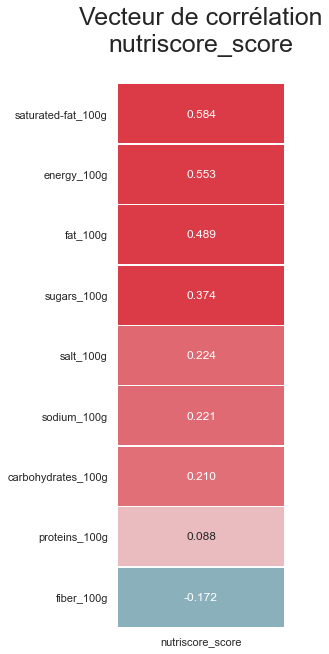

In [94]:
# Affichage du veteur de corrélation
dataframe = data.drop(columns=['nutriscore_grade'])
cible = 'nutriscore_score'
correlation_vecteur(dataframe, cible)

En analysant ce vecteur de corrélation, nous pouvons constater que le score de nutrition est positivement corrélé à :

* saturated_fat_100g
* energy_100g
* fat_100g
* sugars_100g

Corrélé dans une moindre mesure à :

* salt_100g (sodium_100g)

Et pas corrélé avec :

* proteins_100g
* fiber_100g

Cela est cohérent avec le fait qu'un aliment est d'autant meilleur pour la santé que son score de nutrition est bas.

#### Test d'indépendance entre la cible 'nutriscore_score' et chacune des variables retenues

##### Test du Chi2

In [95]:
data.select_dtypes(include = ['float64']).columns

Index(['energy_100g', 'fat_100g', 'saturated-fat_100g', 'carbohydrates_100g',
       'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g',
       'sodium_100g', 'nutriscore_score'],
      dtype='object')

In [89]:
from scipy.stats import chi2_contingency
from scipy.stats import chi2
def test_chi2(serie1, serie2):
    
    alpha = 0.03    
    
    #H0 : les variables sont indépendantes
    
    #print('tableau de contingence :\n', pd.crosstab(serie1.array, serie2.array))
    tab_contingence = pd.crosstab(serie1.array, serie2.array)
    stat_chi2, p, dof, expected_table = chi2_contingency(tab_contingence.values)
    print('chi2 : {0:.5f},\np : {0:.5f},\ndof : {0:.5f}\n'.format(stat_chi2, p, dof))
    #print('tableau de contingence : \n', tab_contingence)
    
    critical = chi2.ppf(1-alpha, dof) #
    #print('critital : ', critical)

    if p <= alpha:
        print('Variables dépendantes (H0 rejetée) car p = {} <= alpha = {}'.format(p, alpha))
        return False
    
    else:
        print('H0 non rejetée car p = {} >= alpha = {}'.format(p, alpha))
        return True

In [100]:
x = pd.cut(data['nutriscore_score'], 20)
for col in data.select_dtypes(include = ['float64']).columns:
    print('test d\'indépendance {} / {}'.format('nutriscore',column))
    if data[col].nunique() > 20 :
        y = pd.cut(data[col], 20).astype('category')
    else:
        y = data[col].astype('category')
    test_chi2(x, y)
    print('-------------------------------------------------------------------------------------------------------------\n')

test d'indépendance nutriscore / nutriscore_score
chi2 : 563.34697,
p : 563.34697,
dof : 563.34697

Variables dépendantes (H0 rejetée) car p = 1.7120512165065165e-75 <= alpha = 0.03
-------------------------------------------------------------------------------------------------------------

test d'indépendance nutriscore / nutriscore_score
chi2 : 150062.16673,
p : 150062.16673,
dof : 150062.16673

Variables dépendantes (H0 rejetée) car p = 0.0 <= alpha = 0.03
-------------------------------------------------------------------------------------------------------------

test d'indépendance nutriscore / nutriscore_score
chi2 : 29796.17902,
p : 29796.17902,
dof : 29796.17902

Variables dépendantes (H0 rejetée) car p = 0.0 <= alpha = 0.03
-------------------------------------------------------------------------------------------------------------

test d'indépendance nutriscore / nutriscore_score
chi2 : 60911.25515,
p : 60911.25515,
dof : 60911.25515

Variables dépendantes (H0 rejetée) car

##### Test selon corrélation de Pearson

In [99]:
from scipy.stats import pearsonr
for col in data.select_dtypes('float64'):
    stat, p = pearsonr(data['nutriscore_score'], data[col])
    print('stat=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        print('nutriscore_score / ', col, ' : Variables probablement indépendantes')
    else:
        print('nutriscore_score / ', col, ' : Variables probablement dépendantes')

stat=0.553, p=0.000
nutriscore_score /  energy_100g  : Variables probablement dépendantes
stat=0.489, p=0.000
nutriscore_score /  fat_100g  : Variables probablement dépendantes
stat=0.584, p=0.000
nutriscore_score /  saturated-fat_100g  : Variables probablement dépendantes
stat=0.210, p=0.000
nutriscore_score /  carbohydrates_100g  : Variables probablement dépendantes
stat=0.374, p=0.000
nutriscore_score /  sugars_100g  : Variables probablement dépendantes
stat=-0.087, p=0.000
nutriscore_score /  fiber_100g  : Variables probablement dépendantes
stat=0.088, p=0.000
nutriscore_score /  proteins_100g  : Variables probablement dépendantes
stat=0.224, p=0.000
nutriscore_score /  salt_100g  : Variables probablement dépendantes
stat=0.221, p=0.000
nutriscore_score /  sodium_100g  : Variables probablement dépendantes
stat=1.000, p=0.000
nutriscore_score /  nutriscore_score  : Variables probablement dépendantes


##### Test selon corrélation de rang de Spearman

In [101]:
from scipy.stats import spearmanr
for col in data.select_dtypes('float64'):
    stat, p = spearmanr(data['nutriscore_score'], data[col])
    print('stat=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        print('nutriscore_score / ', col, ' : Variables probablement indépendantes')
    else:
        print('nutriscore_score / ', col, ' : Variables probablement dépendantes')

stat=0.618, p=0.000
nutriscore_score /  energy_100g  : Variables probablement dépendantes
stat=0.608, p=0.000
nutriscore_score /  fat_100g  : Variables probablement dépendantes
stat=0.657, p=0.000
nutriscore_score /  saturated-fat_100g  : Variables probablement dépendantes
stat=0.128, p=0.000
nutriscore_score /  carbohydrates_100g  : Variables probablement dépendantes
stat=0.260, p=0.000
nutriscore_score /  sugars_100g  : Variables probablement dépendantes
stat=-0.046, p=0.000
nutriscore_score /  fiber_100g  : Variables probablement dépendantes
stat=0.111, p=0.000
nutriscore_score /  proteins_100g  : Variables probablement dépendantes
stat=0.319, p=0.000
nutriscore_score /  salt_100g  : Variables probablement dépendantes
stat=0.319, p=0.000
nutriscore_score /  sodium_100g  : Variables probablement dépendantes
stat=1.000, p=0.000
nutriscore_score /  nutriscore_score  : Variables probablement dépendantes


##### Test selon corrélation de rang de Kendall

In [103]:
from scipy.stats import kendalltau
for col in data.select_dtypes('float64'):
    stat, p = kendalltau(data['nutriscore_score'], data[col])
    print('stat=%.3f, p=%.3f' % (stat, p))
    if p > 0.05:
        print('nutriscore_score / ', col, ' : Variables probablement indépendantes')
    else:
        print('nutriscore_score / ', col, ' : Variables probablement dépendantes')

stat=0.455, p=0.000
nutriscore_score /  energy_100g  : Variables probablement dépendantes
stat=0.437, p=0.000
nutriscore_score /  fat_100g  : Variables probablement dépendantes
stat=0.481, p=0.000
nutriscore_score /  saturated-fat_100g  : Variables probablement dépendantes
stat=0.091, p=0.000
nutriscore_score /  carbohydrates_100g  : Variables probablement dépendantes
stat=0.182, p=0.000
nutriscore_score /  sugars_100g  : Variables probablement dépendantes
stat=-0.032, p=0.000
nutriscore_score /  fiber_100g  : Variables probablement dépendantes
stat=0.070, p=0.000
nutriscore_score /  proteins_100g  : Variables probablement dépendantes
stat=0.222, p=0.000
nutriscore_score /  salt_100g  : Variables probablement dépendantes
stat=0.222, p=0.000
nutriscore_score /  sodium_100g  : Variables probablement dépendantes
stat=1.000, p=0.000
nutriscore_score /  nutriscore_score  : Variables probablement dépendantes


**En conclusion** : les différents tests effectués nous donnent une assurance raisonnable que **les couples de variables** ('nutriscore_score', variable retenue) **sont dépendants.**

#### **Au terme de notre analyse bivariée, nous retirons de notre jeu de données les variables 'fiber_100g' et 'sodium_100g'**

In [98]:
data = data.drop(columns=['sodium_100g', 'fiber_100g'])

In [99]:
data.head()

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,5.1,4.60,18.0,d
1,134.0,0.3,0.1,5.3,3.9,0.9,0.42,1.0,b
2,1594.0,22.0,15.5,27.3,21.9,4.6,0.10,14.0,d
3,657.0,0.0,0.0,36.0,27.0,0.6,0.00,-2.0,a
4,598.0,12.7,1.0,3.9,1.0,1.9,0.27,1.0,b


Nous nous retrouvons ainsi avec 7 variables explicatives du nutriscore.

#### Sauvegarde du fichier épuré au terme de l'analyse bivariée

In [101]:
data_cleaned_bivarie = data

data_cleaned_bivarie.to_csv("C:\openclassrooms\Projet_3\data_cleaned_bivarie.csv")

data_cleaned_bivarie.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183634 entries, 0 to 183633
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   energy_100g         183634 non-null  float64
 1   fat_100g            183634 non-null  float64
 2   saturated-fat_100g  183634 non-null  float64
 3   carbohydrates_100g  183634 non-null  float64
 4   sugars_100g         183634 non-null  float64
 5   proteins_100g       183634 non-null  float64
 6   salt_100g           183634 non-null  float64
 7   nutriscore_score    183634 non-null  float64
 8   nutriscore_grade    183634 non-null  object 
dtypes: float64(8), object(1)
memory usage: 12.6+ MB


## 5. ANALYSE MULTIVARIEE - ACP

Il apparaît difficile à ce point de notre étude de réduire encore plus le nombre de variables. **Voyons néanmoins ce que nous livre l'analyse en composantes principales (ACP).**

Les fonctions pour afficher le cercle des corrélations et les projections sur les plans factoriels se trouvent dans le fichier functions.py.

In [108]:
# Import du fichier cleané au terme de l'analyse bivariée
path_file = "data_cleaned_bivarie.csv"
data = pd.read_csv(path_file)
data.head(2)

,Unnamed: 0,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,nutriscore_score,nutriscore_grade
0,0,936.0,8.2,2.2,29.0,22.0,5.1,4.60,18.0,d
1,1,134.0,0.3,0.1,5.3,3.9,0.9,0.42,1.0,b


In [107]:
# Prépartion du jeu de données pour l'analyse ACP
data_pca = data.drop(columns=['Unnamed: 0','nutriscore_grade','nutriscore_score'])
data_pca.head(2)

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g
0,936.0,8.2,2.2,29.0,22.0,5.1,4.60
1,134.0,0.3,0.1,5.3,3.9,0.9,0.42


* **Analyse en composantes principales**

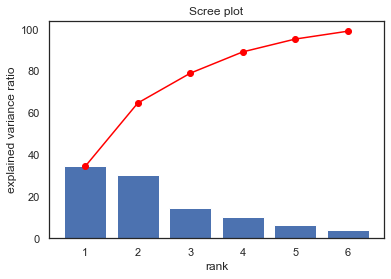

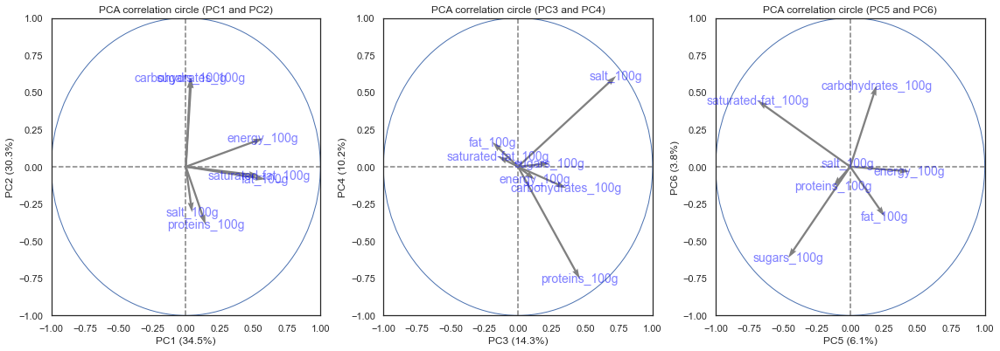

In [109]:
## ACP : ANALYSE EN COMPOSANTES PRINCIPALES

# choix du nombre de composantes à calculer
n_comp = 6

# préparation des données pour l'ACP
X = data_pca.values
features = data_pca.columns

# Centrage et Réduction
std_scale = preprocessing.StandardScaler().fit(X)
X_scaled = std_scale.transform(X)

# Calcul des composantes principales
pca = decomposition.PCA(n_components=n_comp)
pca.fit(X_scaled)

# Eboulis des valeurs propres
display_scree_plot(pca)

# Cercle des corrélations
pcs = pca.components_
display_circles(pcs, n_comp, pca, [(0,1),(2,3),(4,5)], labels = np.array(features))

X_projected = pca.fit_transform(X_scaled)
DataFrame_pca = pd.DataFrame(X_projected, index=data_pca.index, columns=["PC" + str(i+1) for i in range(6)])

# Projection des individus
#X_projected = pca.transform(X_scaled)
#display_factorial_planes(X_projected, n_comp, pca, [(0,1),(2,3),(4,5)], labels = np.array(names))

plt.show()

* **Combinaison linéaire des autres variables pour chacun des axes du plan factoriel**

In [110]:
pc1 = pca.components_[0]
pc1

array([0.57278541, 0.59214625, 0.5429946 , 0.03356341, 0.0406271 ,
       0.14675745, 0.04606242])

In [111]:
pc2 = pca.components_[1]
pc2

array([ 0.19000454, -0.08405863, -0.05900499,  0.59495979,  0.59529203,
       -0.3888213 , -0.30629899])

In [112]:
pc3 = pca.components_[2]
pc3

array([ 0.12498662, -0.19006492, -0.1502569 ,  0.35783707,  0.23567635,
        0.45916389,  0.72887197])

In [113]:
pc4 = pca.components_[3]
pc4

array([-0.08608111,  0.16511706,  0.06977021, -0.14347145,  0.02283529,
       -0.75331211,  0.60981462])

In [114]:
pc5 = pca.components_[4]
pc5

array([ 0.44184428,  0.25626381, -0.68781514,  0.19570499, -0.46014895,
       -0.12490447, -0.01934425])

In [115]:
pc6 = pca.components_[5]
pc6

array([-0.03171218, -0.3339898 ,  0.44352233,  0.54545775, -0.6125462 ,
       -0.13211458,  0.02327711])

In [116]:
DataFrame_pca

,PC1,PC2,PC3,PC4,PC5,PC6
0,-0.570106,-0.022610,1.559554,1.473419,-0.105657,-0.174695
1,-1.757266,-0.371121,-0.928786,0.535741,-0.094870,0.011892
2,1.019193,0.727363,-0.587812,0.156761,-0.563665,0.146063
3,-1.335401,1.278863,-0.318064,0.222950,-0.150109,-0.139359
4,-0.983364,-0.471919,-1.061363,0.466341,0.300721,-0.130851
...,...,...,...,...,...,...
183629,-1.631892,0.008315,-0.937086,0.348230,0.118707,0.303312
183630,-0.461235,-0.334809,0.143946,-0.083702,0.167283,0.181172
183631,3.246162,0.837401,-0.682030,0.081584,-0.910405,0.170586
183632,-0.646599,1.290433,0.405050,-0.707301,1.198629,1.530939


#### Étudions les corrélations entre les variables initiales et les composantes principales 

Rappelons que la projection de la flèche (représentant la variable v ) sur un axe principal (représentant une composante principale) correspond au coefficient de corrélation entre v et cet axe.

Nous observons que :

*      energy_100g et saturated_10g sont correctement positivement corrélés à l'axe PC1.
*      carbohydrates_100g est positivement corrélé à l'axe PC2.
*      salt_100g et proteins_100g sont faiblement corrélés négativement à l'axe PC2 mais correctement corrélés positivement sur l'axe PC3.
    
Pour mémoire, Le nombre maximal de composantes d’une ACP sera le minimum entre p (le nombre de variables) et n-1 (le nombre d'individus -1).

Ici, le maximun sera donc de 7.

En ACP, on projette les données sur les axes principaux d’inertie, et ceux-ci sont ordonnés selon l’inertie du nuage projeté : de la plus grande à la plus petite.

Quand on additionne les inerties associées à tous les axes, on obtient l’inertie totale du nuage des individus.

On peut donc afficher un diagramme qui décrit le pourcentage d’inertie totale associé à chaque axe : Ebouli des valeurs propres.

Un échantillon sans aucune structure est un échantillon pour lequel les variables n’ont aucune corrélation entre elles : elles sont toutes indépendantes deux à deux.

L’extrême inverse serait un échantillon pour lequel toutes les variables sont corrélées deux à deux avec un coefficient de corrélation de 1. C’est le cas où tous les points sont parfaitement alignés. Comme tous les points sont alignés, il n’y a besoin que d’un seul axe pour capter 100 % de l’inertie totale : il suffit de le placer dans l'alignement des points !

Ici, les 2 premiers plans factoriels (composantes principales PC1, PC2, PC3, PC4) représentent prés de 90 % de l'inertie totale. On pourrait donc se contenter d'analyser les 4 premières composantes principales, ce qui constituerait une réduction de nos dimensions de 42 % (de 7 à 4).

#### Choix des composantes principales

* **Valeurs propres (λk, variances) associées aux axes factoriels et règle de Kaiser**

In [8]:
print(pca.explained_variance_) 

[2.41229873 2.11882704 0.99808758 0.71382644 0.42961821 0.26274947]


Nous vérifions que la somme des valeurs propres correspond au nombre de variables, soit 7.

La règle de Kaiser repose sur une idée simple. Dans une ACP normée, la somme des valeurs propres étant égale au nombre de variables, leur moyenne vaut 1. Nous considérons par conséquent qu'**un axe est intéressant si sa valeur propre est supérieur à 1**. Selon cette règle, **nous ne retiendrions que les 2 premiers axes.**

* **Critère du coude**

Sur l'éboulis des valeurs propres, on observe un **décrochement sur l'axe 3**. Ce critère nous conduit également à **ne retenir que les 2 premiers axes** situés avant le décrochement.

* **En conclusion**

L'application de ces 2  critères nous conduit à **retenir les axes PC1 et PC2 qui expliquent à eux deux prés de 65 % de l'inertie totale.**
**Ajoutons** néanmoins **les 2 axes suivants** pour expliquer un **taux d'inertie plus important à 89.3 %.**
Ce faisant, nous réduisons nos dimensions de 7 variables initiales à 4 composantes principales.

#### Sauvegarde du fichier DataFrame_pca

In [118]:
DataFrame_pca.to_csv("C:\openclassrooms\Projet_3\DataFrame_pca.csv")

DataFrame_pca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 183634 entries, 0 to 183633
Data columns (total 6 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   PC1     183634 non-null  float64
 1   PC2     183634 non-null  float64
 2   PC3     183634 non-null  float64
 3   PC4     183634 non-null  float64
 4   PC5     183634 non-null  float64
 5   PC6     183634 non-null  float64
dtypes: float64(6)
memory usage: 8.4 MB


## 6. PREDICTION DU NUTRISCORE A PARTIR DES COMPOSANTES PRINCIPALES PC1 A PC4

**PyCaret** est une bibliothèque d'apprentissage automatique open source à faible code en Python qui automatise les flux de travail d'apprentissage automatique. Il s'agit d'un **outil d'apprentissage automatique et de gestion de modèles** de bout en bout qui accélère le cycle d'expérimentation de manière exponentielle et rend plus productif.

En comparaison avec les autres bibliothèques d'apprentissage automatique open source, PyCaret est une bibliothèque alternative low-code qui peut être utilisée pour remplacer des centaines de lignes de code par quelques mots seulement. Cela rend les expériences exponentiellement rapides et efficaces. PyCaret est essentiellement un wrapper Python autour de plusieurs bibliothèques et frameworks d'apprentissage automatique tels que scikit-learn, XGBoost, LightGBM, CatBoost, spaCy, Optuna, Hyperopt, Ray et bien d'autres.

In [1]:
import pandas as pd
path_file = "DataFrame_pca.csv"
Dataframe = pd.read_csv(path_file)
Dataframe = Dataframe.drop(['Unnamed: 0'],axis=1)
Dataframe.head()

,PC1,PC2,PC3,PC4,PC5,PC6
0,-0.570106,-0.022610,1.559554,1.473419,-0.105657,-0.174695
1,-1.757266,-0.371121,-0.928786,0.535741,-0.094870,0.011892
2,1.019193,0.727363,-0.587812,0.156761,-0.563665,0.146063
3,-1.335401,1.278863,-0.318064,0.222950,-0.150109,-0.139359
4,-0.983364,-0.471919,-1.061363,0.466341,0.300721,-0.130851


In [2]:
# Import du fichier cleané au terme de l'analyse bivariée
path_file = "data_cleaned_bivarie.csv"
data = pd.read_csv(path_file).drop(['Unnamed: 0'],axis=1)
data.head(2)

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,nutriscore_score,nutriscore_grade
0,936.0,8.2,2.2,29.0,22.0,5.1,4.60,18.0,d
1,134.0,0.3,0.1,5.3,3.9,0.9,0.42,1.0,b


In [3]:
Dataframe['nutriscore_score'] = data['nutriscore_score']
Dataframe = Dataframe.drop(columns=['PC5', 'PC6'])
Echantillon = Dataframe
Dataframe.head(2)

,PC1,PC2,PC3,PC4,nutriscore_score
0,-0.570106,-0.022610,1.559554,1.473419,18.0
1,-1.757266,-0.371121,-0.928786,0.535741,1.0


In [5]:
data = Echantillon.sample(frac=0.8)
data_unseen = Echantillon.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (146907, 5)
Unseen Data For Predictions: (36727, 5)


In [53]:
from pycaret.regression import *
exp_reg101 = setup(data = data, target = 'nutriscore_score', session_id=123)

,Description,Value
0,session_id,123
1,Target,nutriscore_score
2,Original Data,"(183634, 8)"
3,Missing Values,False
4,Numeric Features,7
5,Categorical Features,0
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(128543, 7)"


**Choix du modele**

In [7]:
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,1.6677,8.2155,2.8661,0.8954,0.4175,0.3681,3.5770
rf,Random Forest Regressor,1.7373,8.3419,2.8881,0.8937,0.4207,0.3811,9.3480
knn,K Neighbors Regressor,1.8410,9.2198,3.0362,0.8826,0.4366,0.4038,0.1220
catboost,CatBoost Regressor,2.0720,9.4989,3.0818,0.8790,0.4518,0.4419,7.9760
xgboost,Extreme Gradient Boosting,2.0930,9.7269,3.1187,0.8761,0.4588,0.4461,4.3880
lightgbm,Light Gradient Boosting Machine,2.2041,10.2477,3.2010,0.8695,0.4666,0.4659,0.4340
gbr,Gradient Boosting Regressor,2.5975,13.0365,3.6105,0.8339,0.5186,0.5213,5.3380
dt,Decision Tree Regressor,2.0852,14.8640,3.8552,0.8107,0.5009,0.4623,0.2780
ada,AdaBoost Regressor,4.4308,27.8107,5.2723,0.6459,0.6180,0.9413,2.1180
lr,Linear Regression,4.8279,38.8824,6.2338,0.5046,0.6962,0.9976,0.4920


Pycaret nous aide à mieux cibler les modèles d'apprentissage les plus adaptés à notre jeu de données. Dans notre application, **les modèles Extra Trees Regressor et  Random Forest Regressor semblent les plus appropriés.** Extra Trees et Random Forest sont en fait deux méthodes d'ensemble très similaires. Les méthodes d'ensemble d' arbres sont meilleures que les simples arbres de décision. 

Forest Random utilise des réplicas bootstrap , c'est-à-dire qu'elle sous-échantillonne les données d'entrée avec remplacement, tandis que Extra Trees utilise l'ensemble de l'échantillon d'origine. 

Une autre différence est la sélection des points de coupe afin de diviser les nœuds. Random Forest choisit la répartition optimale tandis que Extra Trees la choisit au hasard . Cependant, une fois les points de partage sélectionnés, les deux algorithmes choisissent le meilleur parmi tous les sous-ensembles d'entités. Par conséquent, Extra Trees ajoute la randomisation mais dispose toujours d'une optimisation.

Ces différences motivent la réduction à la fois du biais et de la variance. D'une part, l'utilisation de l'ensemble de l'échantillon d'origine au lieu d'une réplique bootstrap réduira le biais. D'un autre côté, choisir au hasard le point de partage de chaque nœud réduira la variance.

En termes de coût de calcul, et donc de temps d'exécution, l'algorithme Extra Trees est plus rapide . Cet algorithme fait gagner du temps car toute la procédure est la même, mais il choisit au hasard le point de partage et ne calcule pas le point optimal.

**MODELE RANDOM FOREST**

In [5]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from math import sqrt

X = Dataframe
y = X['nutriscore_score']
X = X.drop(['nutriscore_score'],axis=1)

scaler = StandardScaler()
X = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=0)

In [6]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50],
    'verbose' : [1]
}

rfr = GridSearchCV(RandomForestRegressor(), params, cv = 5)

In [7]:
rfr.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   20.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   19.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   17.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'n_estimators': [50], 'verbose': [1]})

In [8]:
rfr.best_estimator_

RandomForestRegressor(n_estimators=50, verbose=1)

In [9]:
print('R² sur jeu d\'entraînement : ', rfr.best_estimator_.score(X_train,y_train))
print('R² sur jeu de test', rfr.best_estimator_.score(X_test,y_test))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    1.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


R² sur jeu d'entraînement :  0.9820335411123914
R² sur jeu de test 0.8983600038741649


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.4s finished


In [10]:
print('RMSE = ', sqrt(mean_squared_error(y_test, rfr.best_estimator_.predict(X_test))))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


RMSE =  2.8257487749928596


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished
C:\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(-15.113000000000001, 39.293, -16.7, 42.7)

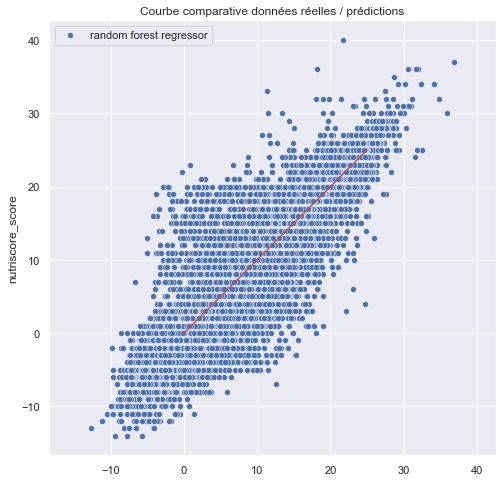

In [14]:
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
plt.figure(figsize=(8,8))
plt.title('Courbe comparative données réelles / prédictions')
sns.scatterplot(x = rfr.predict(X_test),y = y_test)
plt.legend(['random forest regressor'])
sns.lineplot([0,25],[0,25], color='r')
ax = plt.gca()
ax.set_xlim(0,25)
ax.set_ylim(0,25)
ax.axis('equal')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.4s finished
C:\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


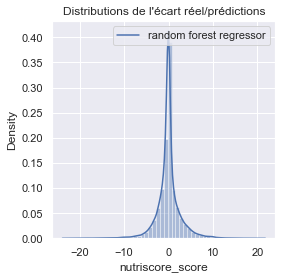

In [15]:
plt.figure(figsize=(4,4))
plt.title('Distributions de l\'écart réel/prédictions')
sns.distplot(rfr.predict(X_test) -  y_test)
plt.legend(['random forest regressor'])

In [16]:
rfr.best_estimator_.feature_importances_

array([0.59401599, 0.12775273, 0.1254393 , 0.15279197])

In [17]:
random_forest_features = pd.DataFrame({'feature' : Dataframe.drop(['nutriscore_score'],axis=1).columns,
                                      'importance' : rfr.best_estimator_.feature_importances_})

In [18]:
random_forest_features.sort_values(by='importance',ascending=False, inplace=True)

<AxesSubplot:title={'center':'Importance des variables dans le random forest'}, xlabel='importance', ylabel='feature'>

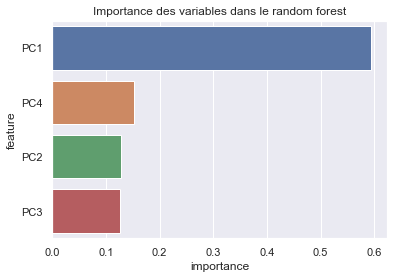

In [19]:
plt.title('Importance des variables dans le random forest')

sns.barplot(y = random_forest_features['feature'], x=random_forest_features['importance'])

**MODELE EXTRA TREES REGRESSOR**

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from math import sqrt

X = Dataframe
y = X['nutriscore_score']
X = X.drop(['nutriscore_score'],axis=1)

scaler = StandardScaler()
X = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=0)

In [21]:
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50],
    'verbose' : [1]
}

etr = GridSearchCV(ExtraTreesRegressor(), params, cv = 5)

In [22]:
etr.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    7.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    7.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    7.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

GridSearchCV(cv=5, estimator=ExtraTreesRegressor(),
             param_grid={'n_estimators': [50], 'verbose': [1]})

In [24]:
etr.best_estimator_

ExtraTreesRegressor(n_estimators=50, verbose=1)

In [25]:
print('R² sur jeu d\'entraînement : ', etr.best_estimator_.score(X_train,y_train))
print('R² sur jeu de test', etr.best_estimator_.score(X_test,y_test))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    2.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


R² sur jeu d'entraînement :  0.9951032276838787
R² sur jeu de test 0.8992540939224005


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.6s finished


In [26]:
print('RMSE = ', sqrt(mean_squared_error(y_test, etr.best_estimator_.predict(X_test))))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


RMSE =  2.8132927800817593


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.6s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.6s finished
C:\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


(-15.5, 39.5, -16.7, 42.7)

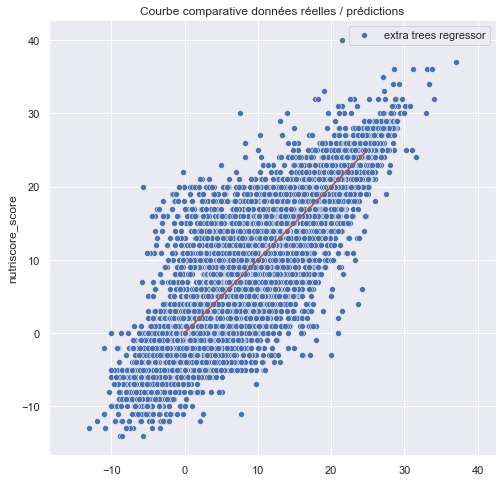

In [27]:
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
plt.figure(figsize=(8,8))
plt.title('Courbe comparative données réelles / prédictions')
sns.scatterplot(x = etr.predict(X_test),y = y_test)
plt.legend(['extra trees regressor'])
sns.lineplot([0,25],[0,25], color='r')
ax = plt.gca()
ax.set_xlim(0,25)
ax.set_ylim(0,25)
ax.axis('equal')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.6s finished
C:\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


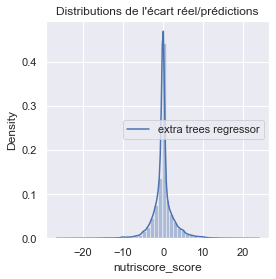

In [28]:
plt.figure(figsize=(4,4))
plt.title('Distributions de l\'écart réel/prédictions')
sns.distplot(etr.predict(X_test) -  y_test)
plt.legend(['extra trees regressor'])

In [29]:
etr.best_estimator_.feature_importances_

array([0.54032512, 0.19337301, 0.10951303, 0.15678884])

In [30]:
extra_trees_features = pd.DataFrame({'feature' : Dataframe.drop(['nutriscore_score'],axis=1).columns,
                                      'importance' : etr.best_estimator_.feature_importances_})

<AxesSubplot:title={'center':'Importance des variables dans le extra trees'}, xlabel='importance', ylabel='feature'>

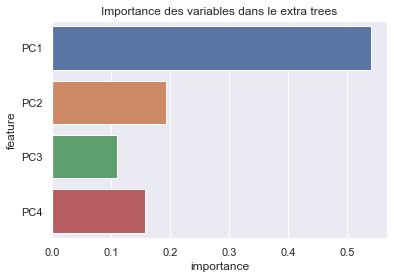

In [31]:
plt.title('Importance des variables dans le extra trees')

sns.barplot(y = extra_trees_features['feature'], x = extra_trees_features['importance'])

**CONCLUSION SUR LA PERTINENCE DE CES 2 MODELES**  

Nous nous appuyons sur 2 indicateurs pour porter un jugement sur la préférence d'une méthode par rapport à l'autre :

* Le coefficient de détermination R2. Plus R2 sera proche de 1, meilleure sera la prédiction. => 

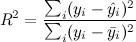

* Un dernier indicateur pertinent est le RMSE (Erreur quadratique moyenne). Cet indice fournit une indication par rapport à la dispersion ou la variabilité de la qualité de la prédiction. => 

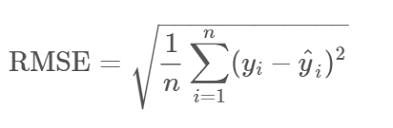

* Tableau comparatif de ces 2 indicateurs

|Indicateur        | Random Forest|Extra Trees|
|-----------|:------------:|:-----------:|
| RMSE |2.82|2.81|
|R2 entraînement|0.98|0.99|
|R2 test|0.89|0.90|


Ces deux modèles sont effectivement extrêmement proches avec une trés légère préférence pour Extra Trees Regressor.

## 7. ANNEXE - CHOIX DU MODELE A PARTIR DES VARIABLES INITIALES - MESURE DE LA PERTE DE PERFORMANCE AVEC LES COMPOSANTES PRINCIPALES

In [33]:
# Import du fichier cleané au terme de l'analyse bivariée
path_file = "data_cleaned_bivarie.csv"
data = pd.read_csv(path_file).drop(['Unnamed: 0', 'nutriscore_grade'],axis=1)
data.head(2)

,energy_100g,fat_100g,saturated-fat_100g,carbohydrates_100g,sugars_100g,proteins_100g,salt_100g,nutriscore_score
0,936.0,8.2,2.2,29.0,22.0,5.1,4.60,18.0
1,134.0,0.3,0.1,5.3,3.9,0.9,0.42,1.0


In [34]:
df = data.sample(frac=0.8)
df_unseen = data.drop(df.index)

df.reset_index(drop=True, inplace=True)
df_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(df.shape))
print('Unseen Data For Predictions: ' + str(df_unseen.shape))

Data for Modeling: (146907, 8)
Unseen Data For Predictions: (36727, 8)


In [55]:
from pycaret.regression import *
exp_reg101 = setup(data = df, target = 'nutriscore_score', session_id=123)

,Description,Value
0,session_id,123
1,Target,nutriscore_score
2,Original Data,"(146907, 8)"
3,Missing Values,False
4,Numeric Features,7
5,Categorical Features,0
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(102834, 7)"


**Choix du modèle**

In [36]:
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
rf,Random Forest Regressor,1.2917,5.5463,2.3548,0.9291,0.3686,0.2923,8.0610
et,Extra Trees Regressor,1.2759,5.5913,2.3643,0.9286,0.3681,0.2859,4.3640
catboost,CatBoost Regressor,1.5209,5.9106,2.4307,0.9245,0.3923,0.3434,7.6360
xgboost,Extreme Gradient Boosting,1.5370,6.0475,2.4589,0.9227,0.3933,0.3440,2.5730
lightgbm,Light Gradient Boosting Machine,1.6445,6.5566,2.5602,0.9162,0.4044,0.3649,0.4710
gbr,Gradient Boosting Regressor,2.0445,8.8061,2.9672,0.8875,0.4457,0.4368,3.0640
dt,Decision Tree Regressor,1.5118,9.8377,3.1360,0.8743,0.4331,0.3490,0.1880
knn,K Neighbors Regressor,2.3872,13.6832,3.6988,0.8252,0.5240,0.5165,0.1480
ada,AdaBoost Regressor,3.4169,17.5422,4.1882,0.7759,0.6154,0.7317,1.8140
lr,Linear Regression,4.4073,31.6109,5.6212,0.5961,0.6242,0.8548,0.5080


### Random Forest Regressor

In [37]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
from math import sqrt

X = df
y = X['nutriscore_score']
X = X.drop(['nutriscore_score'],axis=1)

scaler = StandardScaler()
X = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=0)

In [38]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

params = {
    'n_estimators': [50],
    'verbose' : [1]
}

rfr = GridSearchCV(RandomForestRegressor(), params, cv = 5)

In [39]:
rfr.fit(X_train, y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   16.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   16.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:   16.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_j

GridSearchCV(cv=5, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=None,
                                             verbose=0, warm_start=False),
             iid='deprecated', n_jo

In [40]:
rfr.best_estimator_

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=50, n_jobs=None, oob_score=False,
                      random_state=None, verbose=1, warm_start=False)

In [41]:
print('R² sur jeu d\'entraînement : ', rfr.best_estimator_.score(X_train,y_train))
print('R² sur jeu de test', rfr.best_estimator_.score(X_test,y_test))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    1.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


R² sur jeu d'entraînement :  0.9867551247745328
R² sur jeu de test 0.929425419461041


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished


In [42]:
print('RMSE = ', sqrt(mean_squared_error(y_test, rfr.best_estimator_.predict(X_test))))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


RMSE =  2.3447263892610137


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished


(-15.127, 39.147, -17.6, 39.6)

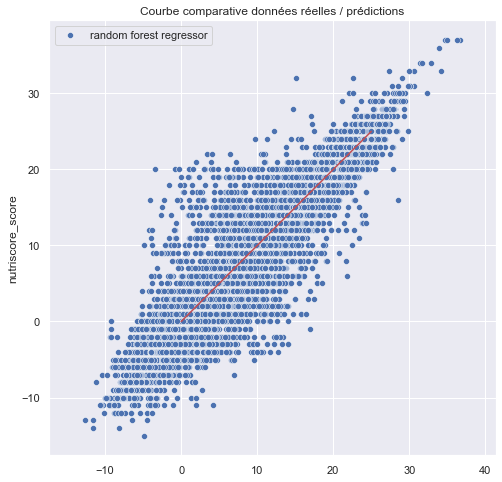

In [43]:
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
plt.figure(figsize=(8,8))
plt.title('Courbe comparative données réelles / prédictions')
sns.scatterplot(x = rfr.predict(X_test),y = y_test)
plt.legend(['random forest regressor'])
sns.lineplot([0,25],[0,25], color='r')
ax = plt.gca()
ax.set_xlim(0,25)
ax.set_ylim(0,25)
ax.axis('equal')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    0.3s finished


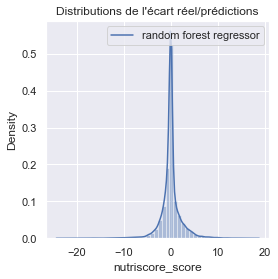

In [44]:
plt.figure(figsize=(4,4))
plt.title('Distributions de l\'écart réel/prédictions')
sns.distplot(rfr.predict(X_test) -  y_test)
plt.legend(['random forest regressor'])

In [45]:
rfr.best_estimator_.feature_importances_

array([0.0599727 , 0.01546439, 0.51811631, 0.02183266, 0.17185117,
       0.03543353, 0.17732923])

In [48]:
random_forest_features = pd.DataFrame({'feature' : df.drop(['nutriscore_score'],axis=1).columns,
                                      'importance' : rfr.best_estimator_.feature_importances_})

In [49]:
random_forest_features.sort_values(by='importance',ascending=False, inplace=True)

<AxesSubplot:title={'center':'Importance des variables dans le random forest'}, xlabel='importance', ylabel='feature'>

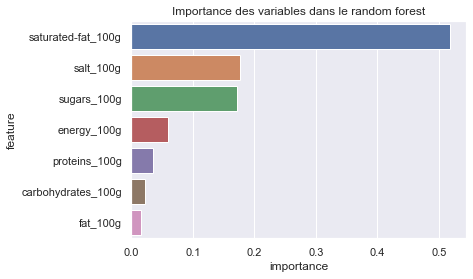

In [50]:
plt.title('Importance des variables dans le random forest')

sns.barplot(y = random_forest_features['feature'], x=random_forest_features['importance'])

**Comparaison effectuée sur le modele Random Forest Regressor**

|Indicateur        | Composantes principales|Variables initiales|
|-----------|:------------:|:-----------:|
| RMSE |2.82|2.34|
|R2 entraînement|0.98|0.98|
|R2 test|0.89|0.93|

Perte légère de performance avec les composantes principales sur le R2 en test.